In [1]:
suppressPackageStartupMessages({
    library(Seurat)
    library(cowplot)
    library(ggplot2)
    library(scran)
    library(pheatmap)
    library(RCurl)
    library(AnnotationHub)
    library(EnsDb.Hsapiens.v86)
    library(BSgenome.Hsapiens.UCSC.hg38)
    library(dplyr)
    library(AUCell)
    library(GSEABase)
    library(future)
})

In [2]:
options(future.globals.maxSize = 8000 * 1024^3)

In [3]:
plan("multiprocess", workers = 30)
plan()

Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


multiprocess:
- args: function (..., workers = 30, envir = parent.frame())
- tweaked: TRUE
- call: plan("multiprocess", workers = 30)

In [4]:
#load data
edge1<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat/glio_rna.edge.filterh5.filter.RData"))
edge2<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat_second/glio_rna.edge.filterh5.filter.RData"))
edge3<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat_third/glio_rna.edge.filterh5.filter.RData"))

In [5]:
#load data
core1<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat/glio_rna.core.filterh5.filter.RData"))
core2<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat_second/glio_rna.core.filterh5.filter.RData"))
core3<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat_third/glio_rna.core.filterh5.filter.RData"))

In [6]:
edge1<-CreateSeuratObject(edge1@assays$RNA@counts, project = "edge1")
edge2<-CreateSeuratObject(edge2@assays$RNA@counts, project = "edge2")
edge3<-CreateSeuratObject(edge3@assays$RNA@counts, project = "edge3")
core1<-CreateSeuratObject(core1@assays$RNA@counts, project = "core1")
core2<-CreateSeuratObject(core2@assays$RNA@counts, project = "core2")
core3<-CreateSeuratObject(core3@assays$RNA@counts, project = "core3")

In [7]:
#add metadata
edge1$type<-"edge"
edge2$type<-"edge"
edge3$type<-"edge"
core1$type<-"core"
core2$type<-"core"
core3$type<-"core"

In [8]:
#add metadata
edge1$patient<-"patient1"
edge2$patient<-"patient2"
edge3$patient<-"patient3"
core1$patient<-"patient1"
core2$patient<-"patient2"
core3$patient<-"patient3"

In [9]:
#add metadata
edge1$sample<-"edge1"
edge2$sample<-"edge2"
edge3$sample<-"edge3"
core1$sample<-"core1"
core2$sample<-"core2"
core3$sample<-"core3"

In [10]:
#add metadata
edge1$sample2<-"sample"
edge2$sample2<-"sample"
edge3$sample2<-"sample"
core1$sample2<-"sample"
core2$sample2<-"sample"
core3$sample2<-"sample"

In [11]:
# Merge datasets into one single seurat object
alldata<-merge(edge1,c(edge2,edge3,core1,core2,core3),add.cell.ids=c("edge1","edge2","edge3","core1","core2","core3"))

In [12]:
length(alldata$orig.ident)

[1] 27670

In [23]:
result<-data.frame(number=c(all_number,all_number2),group=c(rep("RNA",6),rep("ATAC",6)),annotate=c(order,order))

In [24]:
result$annotate<-factor(result$annotate,levels=c("core1","edge1","core2","edge2","core3","edge3"))

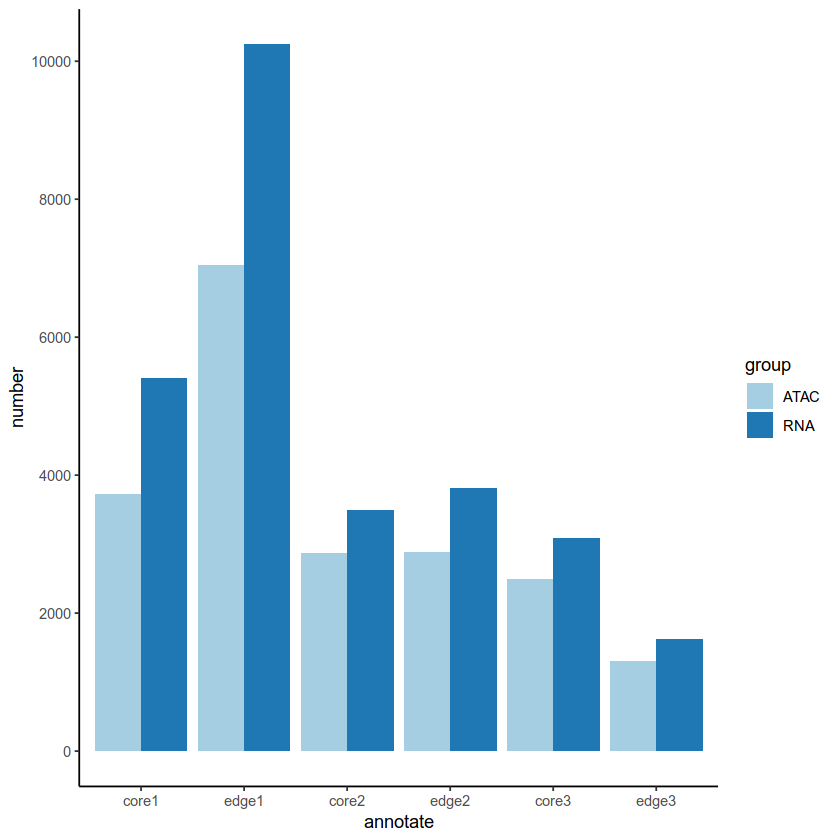

In [25]:
result$number <- as.numeric(as.vector(result$number))
library(ggplot2)
ggplot(data=result, aes(x=annotate, y=number, fill=group)) +
  geom_bar(stat="identity", position=position_dodge())+
  scale_fill_brewer(palette="Paired")+scale_y_continuous(breaks = round(seq(0, max(result$number), by = 2000),1))+
  theme_classic()

In [36]:
pdf("barplot.number.quality.cell.pdf")
ggplot(data=result, aes(x=annotate, y=number, fill=group)) +
  geom_bar(stat="identity", position=position_dodge())+
  scale_fill_brewer(palette="Paired")+scale_y_continuous(breaks = round(seq(0, max(result$number), by = 2000),1))+
  theme_classic()
dev.off()

png 
  2

In [26]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA"

In [27]:
#save(alldata,file="alldata.edge.RData")

In [28]:
total_counts_per_cell<-colSums(alldata@assays$RNA@counts)
mito_gene<-rownames(alldata)[grep("^MT-",rownames(alldata@assays$RNA@counts))]
alldata$percent_mito<-colSums(alldata@assays$RNA@counts[mito_gene,])/total_counts_per_cell

In [29]:
alldata<-PercentageFeatureSet(alldata,"^RP[SL]",col.name="percent_ribo")

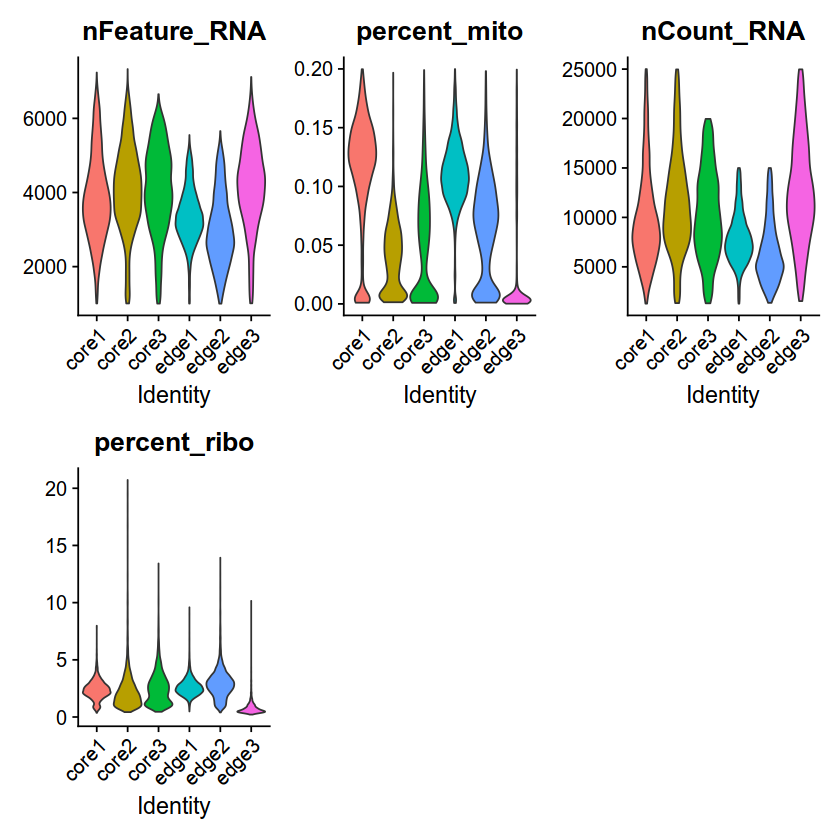

In [30]:
feat<-c("nFeature_RNA","percent_mito","nCount_RNA","percent_ribo")
VlnPlot(alldata,group.by="sample",features=feat,pt.size=0,ncol=3)+NoLegend()

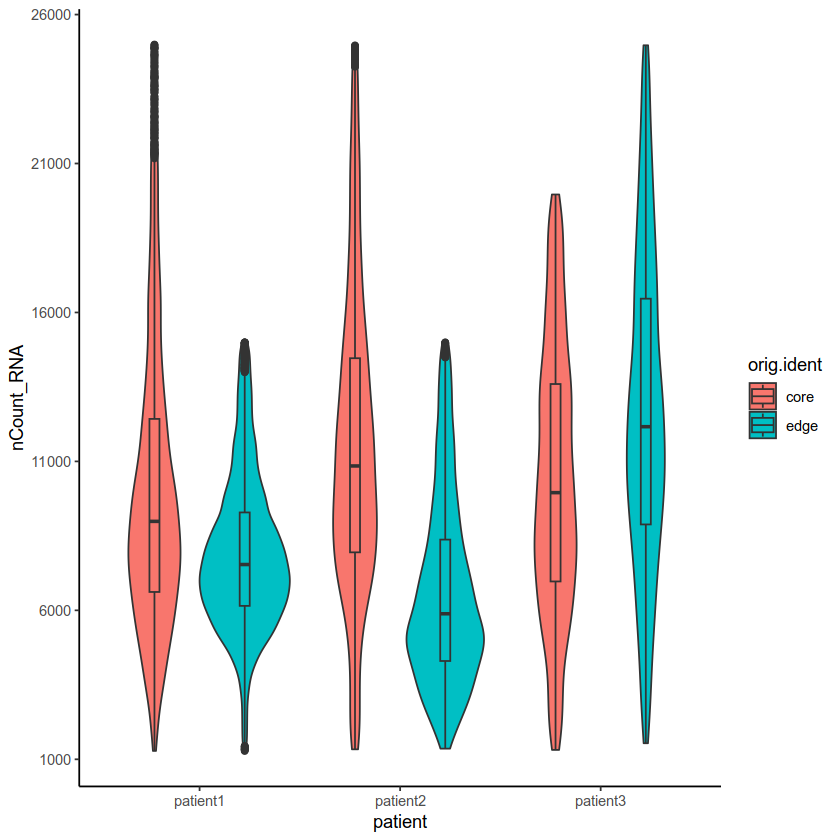

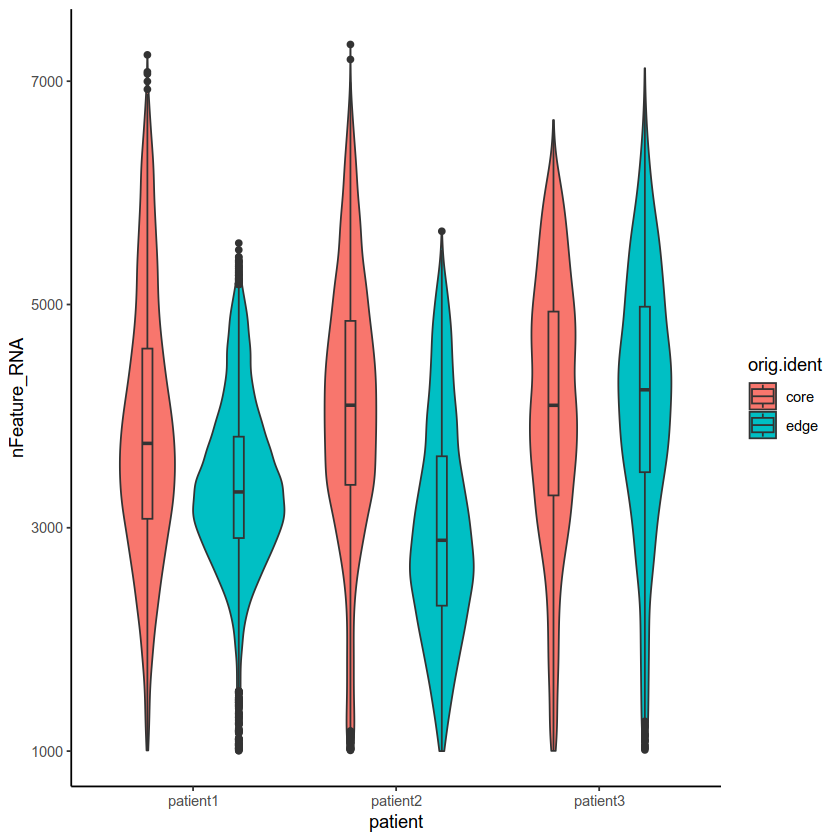

In [31]:
#alldata@meta.data
ggplot(alldata@meta.data, aes(x=patient, y=nCount_RNA,fill=orig.ident))+geom_violin()+geom_boxplot(width=0.1,position=position_dodge(0.9))+scale_y_continuous(breaks = round(seq(1000, 26000, by = 5000),1)) + theme_classic()
ggplot(alldata@meta.data, aes(x=patient, y=nFeature_RNA,fill=orig.ident))+geom_violin()+geom_boxplot(width=0.1,position=position_dodge(0.9))+scale_y_continuous(breaks = round(seq(1000, 8000, by = 2000),1))+NoLegend() + theme_classic()



Scale for y is already present.
Adding another scale for y, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


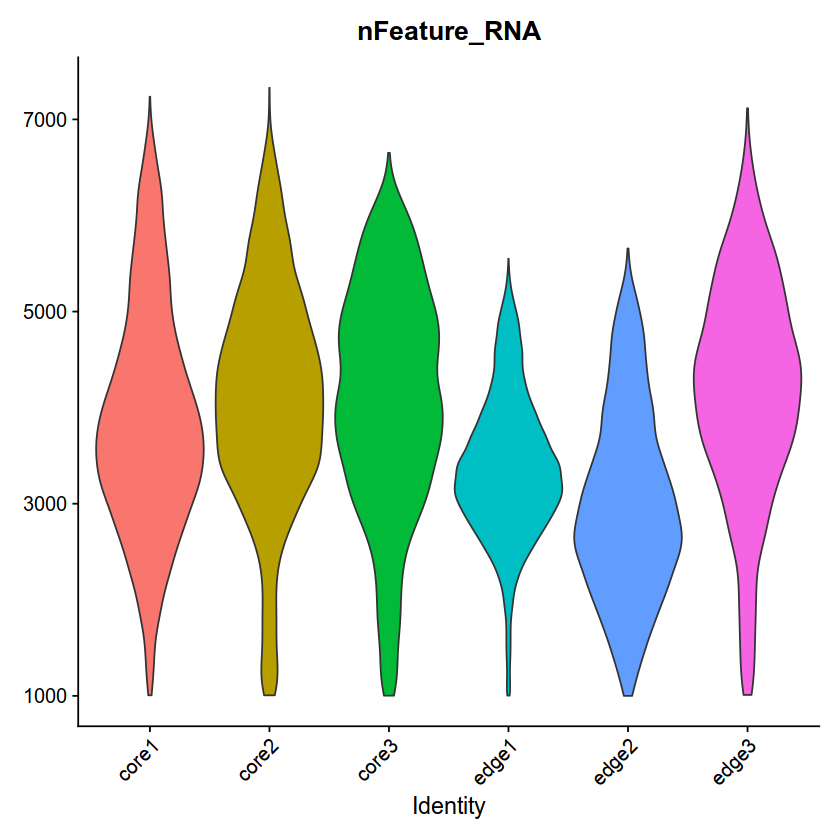

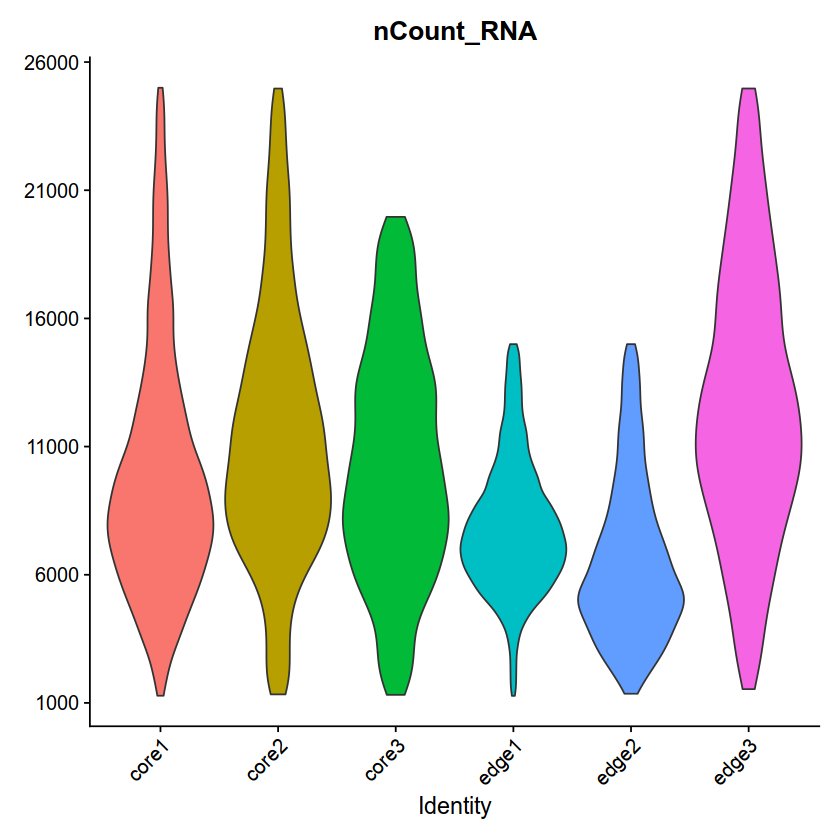

In [32]:
#feat2<-c("nFeature_RNA","nCount_RNA")
VlnPlot(alldata,group.by="sample",features="nFeature_RNA",pt.size=0)+scale_y_continuous(breaks = round(seq(1000, 8000, by = 2000),1))+NoLegend()
VlnPlot(alldata,group.by="sample",features="nCount_RNA",pt.size=0)+scale_y_continuous(breaks = round(seq(1000, 26000, by = 5000),1))+NoLegend()

In [38]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA"

In [37]:
pdf("quanlity.plot.rna.pdf")
#feat2<-c("nFeature_RNA","nCount_RNA")
ggplot(alldata@meta.data, aes(x=patient, y=nCount_RNA,fill=orig.ident))+geom_violin()+geom_boxplot(width=0.1,position=position_dodge(0.9))+scale_y_continuous(breaks = round(seq(1000, 26000, by = 5000),1)) + theme_classic()
ggplot(alldata@meta.data, aes(x=patient, y=nFeature_RNA,fill=orig.ident))+geom_violin()+geom_boxplot(width=0.1,position=position_dodge(0.9))+scale_y_continuous(breaks = round(seq(1000, 8000, by = 2000),1))+NoLegend() + theme_classic()

dev.off()

png 
  2

In [46]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA"

In [47]:
ribo.genes<- c(rownames(alldata@assays$RNA@data)[grep("^RP[1:9]",rownames(alldata@assays$RNA@data))],rownames(alldata@assays$RNA@data)[grep("^RP[L,S]",rownames(alldata@assays$RNA@data))])

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 5.7 GiB"


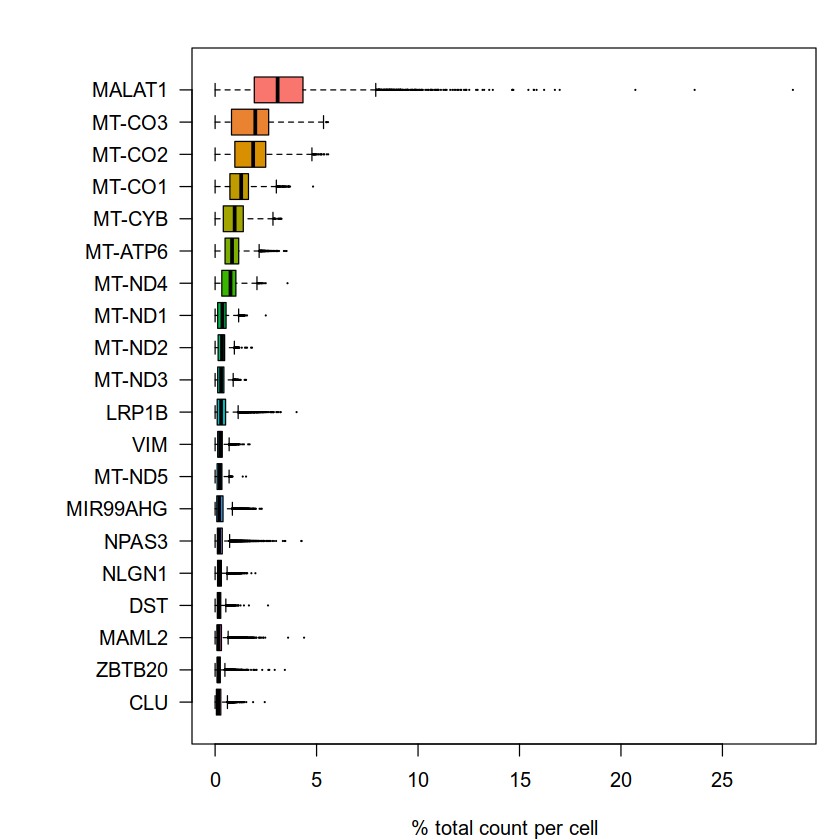

In [48]:
#gene expressiom
par(mar = c(4, 8, 2, 1))
C <- alldata@assays$RNA@counts
C <- Matrix::t(Matrix::t(C)/Matrix::colSums(C)) * 100
most_expressed <- order(apply(C, 1, median), decreasing = T)[20:1]
boxplot(as.matrix(t(C[most_expressed, ])), cex = 0.1, las = 1, xlab = "% total count per cell",
    col = (scales::hue_pal())(20)[20:1], horizontal = TRUE)

In [49]:
mito.genes<- c(rownames(alldata@assays$RNA@data)[grep("^MT",rownames(alldata@assays$RNA@data))])
removed.genes<-c(ribo.genes,"MALAT1",mito.genes)

In [50]:
removed.genes

[1] "RP9"         "RP1L1"       "RP1"         "RPL22"       "RPL11"      
  [6] "RPS6KA1"     "RPS8"        "RPL5"        "RPS27"       "RPS6KC1"    
 [11] "RPS7"        "RPS27A"      "RPL31"       "RPL37A"      "RPL32"      
 [16] "RPL15"       "RPSA"        "RPL14"       "RPL29"       "RPL24"      
 [21] "RPL22L1"     "RPL39L"      "RPL35A"      "RPL9"        "RPL34-AS1"  
 [26] "RPL34"       "RPS3A"       "RPL37"       "RPS23"       "RPS14"      
 [31] "RPL26L1"     "RPS18"       "RPS10-NUDT3" "RPS10"       "RPL10A"     
 [36] "RPL7L1"      "RPS12"       "RPS6KA2"     "RPS6KA2-IT1" "RPS20"      
 [41] "RPL7"        "RPL30"       "RPL8"        "RPS6"        "RPL35"      
 [46] "RPL12"       "RPL7A"       "RPS24"       "RPLP2"       "RPL27A"     
 [51] "RPS13"       "RPS6KA4"     "RPS6KB2"     "RPS6KB2-AS1" "RPS3"       
 [56] "RPS25"       "RPS26"       "RPL41"       "RPL6"        "RPLP0"      
 [61] "RPL21"       "RPS29"       "RPL36AL"     "RPS6KL1"     "RPS6KA5"    
 [66] "RPS27L"      "RPL4"        "RPLP1"       "RPS17"       "RPL3L"      
 [71] "RPS2"        "RPS15A"      "RPL13"       "RPL26"       "RPL23A"     
 [76] "RPL23"       "RPL19"       "RPL27"       "RPS6KB1"     "RPL38"      
 [81] "RPL17"       "RPS15"       "RPL36"       "RPS28"       "RPL18A"     
 [86] "RPS16"       "RPS19"       "RPL18"       "RPL13A"      "RPS11"      
 [91] "RPS9"        "RPL28"       "RPS5"        "RPS21"       "RPL3"       
 [96] "RPS19BP1"    "RPS6KA3"     "RPS4X"       "RPS6KA6"     "RPL36A"     
[101] "RPL39"       "RPL10"       "RPS4Y1"      "MALAT1"      "MTOR"       
[106] "MTOR-AS1"    "MTHFR"       "MTFR1L"      "MTF1"        "MTF2"       
[111] "MTMR11"      "MTX1"        "MTR"         "MTRNR2L11"   "MTA3"       
[116] "MTIF2"       "MTHFD2"      "MTLN"        "MTX2"        "MTERF4"     
[121] "MTMR14"      "MTRNR2L12"   "MTHFD2L"     "MTTP"        "MTRR"       
[126] "MTMR12"      "MTREX"       "MTX3"        "MTCH1"       "MTO1"       
[131] "MTRES1"      "MTFR2"       "MTHFD1L"     "MTRF1L"      "MTURN"      
[136] "MTERF1"      "MTPN"        "MTRNR2L6"    "MTMR9"       "MTMR7"      
[141] "MTUS1"       "MTFR1"       "MTERF3"      "MTDH"        "MTBP"       
[146] "MTSS1"       "MTAP"        "MTPAP"       "MTG1"        "MTRNR2L8"   
[151] "MTCH2"       "MTA2"        "MTNR1B"      "MTMR2"       "MTERF2"     
[156] "MTMR6"       "MTIF3"       "MTUS2"       "MTRF1"       "MTHFD1"     
[161] "MTA1"        "MTMR10"      "MTFMT"       "MTHFS"       "MTRNR2L4"   
[166] "MT3"         "MT2A"        "MT1E"        "MT1M"        "MT1F"       
[171] "MT1G"        "MT1X"        "MTSS2"       "MTHFSD"      "MTRNR2L1"   
[176] "MTMR4"       "MTCL1"       "MTRNR2L3"    "MTG2"        "MTMR3"      
[181] "MTFP1"       "MTRNR2L10"   "MTMR8"       "MTM1"        "MTMR1"      
[186] "MTCP1"       "MT-ND1"      "MT-ND2"      "MT-CO1"      "MT-CO2"     
[191] "MT-ATP8"     "MT-ATP6"     "MT-CO3"      "MT-ND3"      "MT-ND4L"    
[196] "MT-ND4"      "MT-ND5"      "MT-ND6"      "MT-CYB"      "MTNR1A"     
[201] "MTUS2-AS1"

In [51]:
###cell cycle
cc_file <- getURL("https://raw.githubusercontent.com/hbc/tinyatlas/master/cell_cycle/Homo_sapiens.csv")
cell_cycle_genes <- read.csv(text = cc_file)
ah <- AnnotationHub()
ahDb <- query(ah,
              pattern = c("Homo sapiens", "EnsDb"),
              ignore.case = TRUE)
id <- ahDb %>%
        mcols() %>%
        rownames() %>%
        tail(n = 1)
edb <- ah[[id]]
annotations <- genes(edb,
                     return.type = "data.frame")
annotations <- annotations %>%
        dplyr::select(gene_id, gene_name, seq_name, gene_biotype, description)
# Get gene names for Ensembl IDs for each gene
cell_cycle_markers <- dplyr::left_join(cell_cycle_genes, annotations, by = c("geneID" = "gene_id"))

# Acquire the S phase genes
s_genes <- cell_cycle_markers %>%
        dplyr::filter(phase == "S") %>%
        pull("gene_name")

# Acquire the G2M phase genes
g2m_genes <- cell_cycle_markers %>%
        dplyr::filter(phase == "G2/M") %>%
        pull("gene_name")

snapshotDate(): 2022-10-31

loading from cache



In [52]:
alldata<-NormalizeData(alldata, normalization.method = "LogNormalize", scale.factor = 10000)
alldata<-FindVariableFeatures(alldata,selection.method="vst",nfeatures=6000,verbose=T)
alldata <- CellCycleScoring(alldata, s.features = s_genes, g2m.features = g2m_genes, set.ident = TRUE)



Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly sp

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send

In [53]:
alldata$CC.Difference <- alldata$S.Score - alldata$G2M.Score
alldata<-ScaleData(alldata,vars.to.regress=c("CC.Difference","percent_mito","nCount_RNA"))
#alldata<-RunPCA(alldata,features = rownames(alldata@assays$RNA@data)[!rownames(alldata@assays$RNA@data) %in% removed.genes],npcs=100,nfeatures.print=10)
alldata<-RunPCA(alldata,features = VariableFeatures(alldata)[!VariableFeatures(alldata)%in% removed.genes],npcs=100,nfeatures.print=10)





Regressing out CC.Difference, percent_mito, nCount_RNA

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Centering and scaling data matrix

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


PC_ 1 
Positive:  PTN, NCAM1, PTPRZ1, LHFPL3, C1orf61, NAV2, NUP107, SNTG1, NOVA1, MARCKSL1 
Negative:  COL21A1, IGFBP7, AHR, PRICKLE1, COL1A2, EFEMP1, ITGBL1, PALLD, CALD1, DANT2 
PC_ 2 
Positive:  MIR924HG, BRIP1, NLGN4Y, POLQ, NUP107, KIF18B, NCAPG, VCAN, DIAPH3, DTL 
Negative:  LINC02315, XIST, ADGRV1, KCNH7, A2M, RMST, EYA4, SORCS1, AL110292.1, NKAIN3 
PC_ 3 
Positive:  DIAPH3, PLD5, EYA4, CSMD2, ANK3, BRCA2, NEFL, TGFBI, PBX3, CENPP 
Negative:  MAP2, MDGA2, LANCL2, MDM2, CHL1, AC092691.1, DSCAML1, GRIA2, ABCA1, SLC35E3 
PC_ 4 
Positive:  NEFL, TGFBI, COL6A2, SLCO5A1, JAKMIP2-AS1, CACNA1A, COL6A1, PPFIA2, AL117329.1, PDP1 
Negative:  NFIA, NEAT1, FAT3, XIST, FIGN, ITPR2, IGFBP7, TRPM3, NIBAN1, LINC02315 
PC_ 5 
Positive:  COL19A1, TFPI2, ID1, LINC02742, NECTIN3, LINC02755, CADPS, OXR1, DACH1, GAP43 
Negative:  MEOX2, AGMO, MDGA2, TENM1, GRIA2, CHL1, PLCB4, SDK1, VOPP1, IGF2BP3 



In [54]:
alldata<-RunTSNE(alldata,dims=1:30)
alldata<-RunUMAP(alldata,dims=1:30)

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
09:04:52 UMAP embedding parameters a = 0.9922 b = 1.112

09:04:52 Read 27670 rows and found 30 numeric columns

09:04:52 Using Annoy for neighbor search, n_neighbors = 30

09:04:52 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

09:04:55 Writing NN index file to temp file /tmp/RtmpT4LGpK/file87c511ac8ec5

09:04:55 Searching Annoy index using 30 threads, search_k = 3000

09:04:56 Annoy recall = 100%

09:04:58 Commencing smooth kNN distance calibration using 30 threads
 with target n_neighb

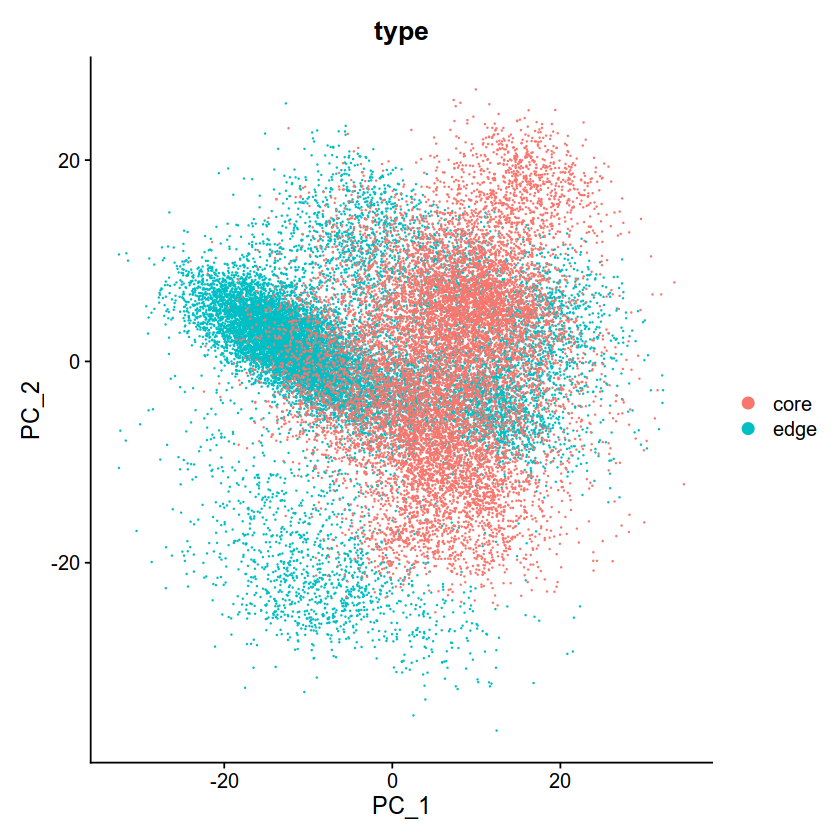

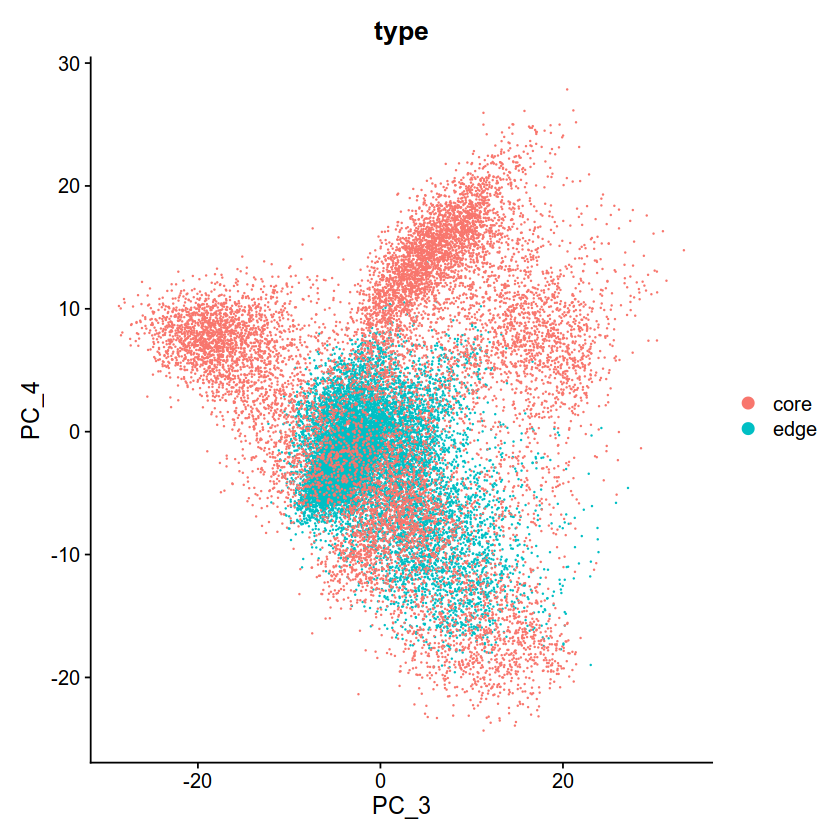

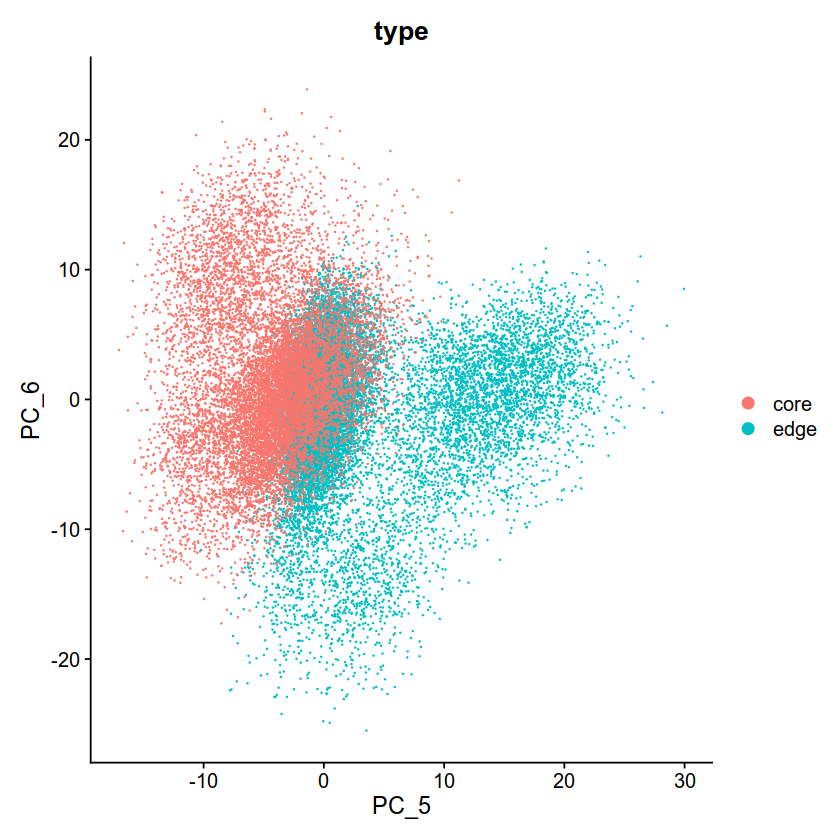

In [55]:
#pca plot 
DimPlot(alldata, reduction = "pca", group.by = "type",dims = 1:2)
DimPlot(alldata, reduction = "pca", group.by = "type", dims = 3:4)
DimPlot(alldata, reduction = "pca", group.by = "type", dims = 5:6)

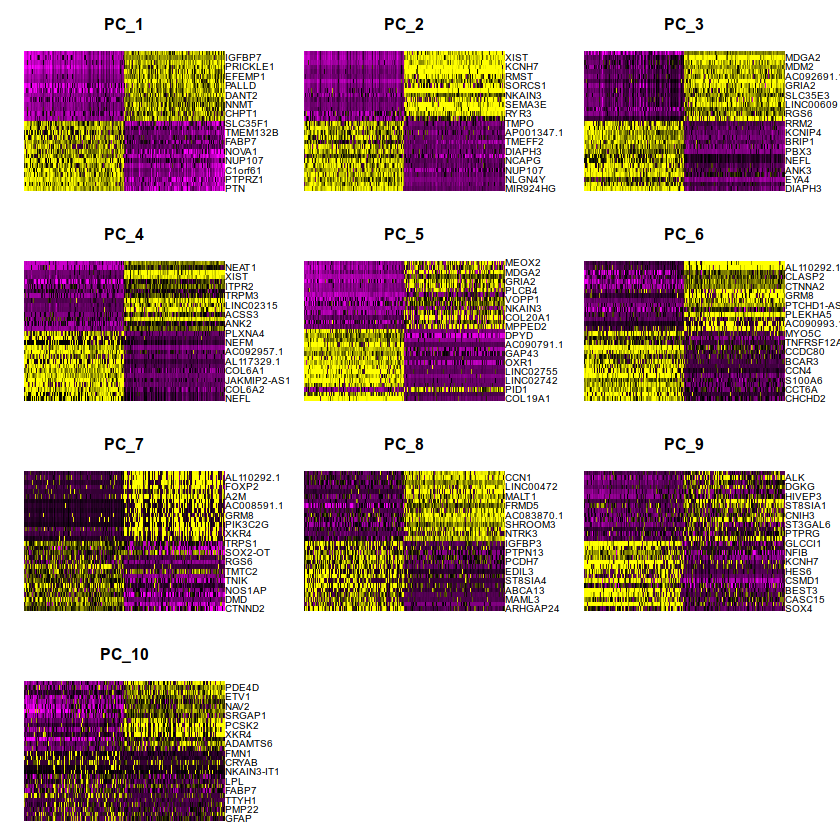

In [56]:
DimHeatmap(alldata, dims = 1:10, cells = 500, balanced = TRUE)

In [57]:
nGenes<-50
pca.genes <- data.frame(alldata@reductions$pca@feature.loadings)

In [58]:
top <- rownames(pca.genes[order(pca.genes$PC_1, decreasing = TRUE), ])[1:nGenes]
bottome<-rownames(pca.genes[order(pca.genes$PC_1,decreasing =F),])[1:nGenes]

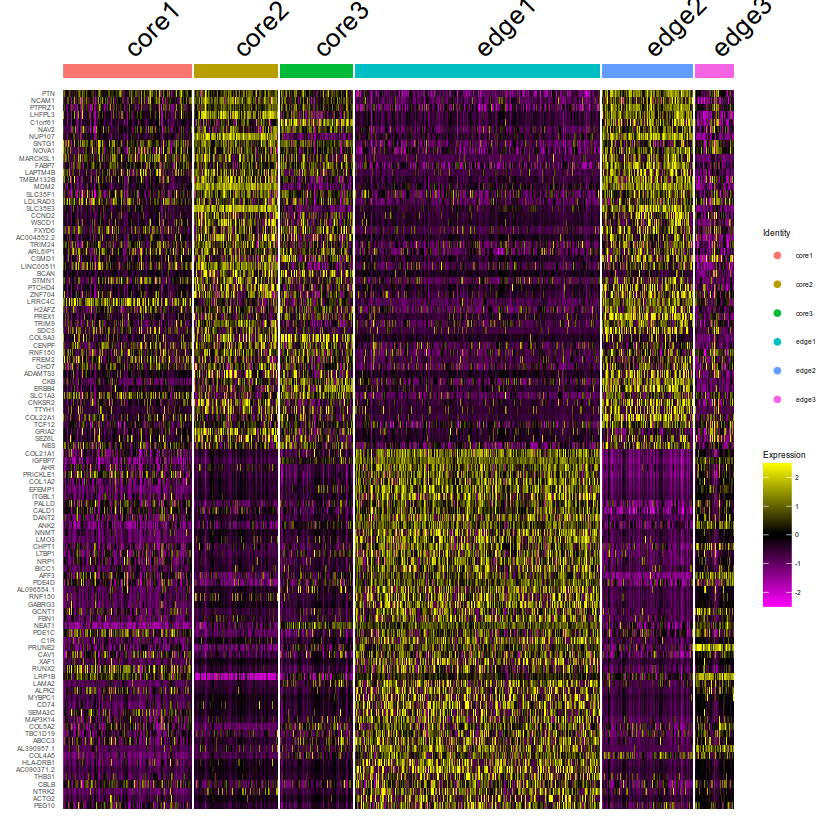

In [59]:
DoHeatmap(alldata, features = as.character(c(top,bottome)), group.by = "sample")+theme(text = element_text(size = 5))

In [60]:
nGenes<-50
pca.genes <- data.frame(alldata@reductions$pca@feature.loadings)

In [61]:
top <- rownames(pca.genes[order(pca.genes$PC_5, decreasing = TRUE), ])[1:nGenes]
bottome<-rownames(pca.genes[order(pca.genes$PC_5,decreasing =F),])[1:nGenes]

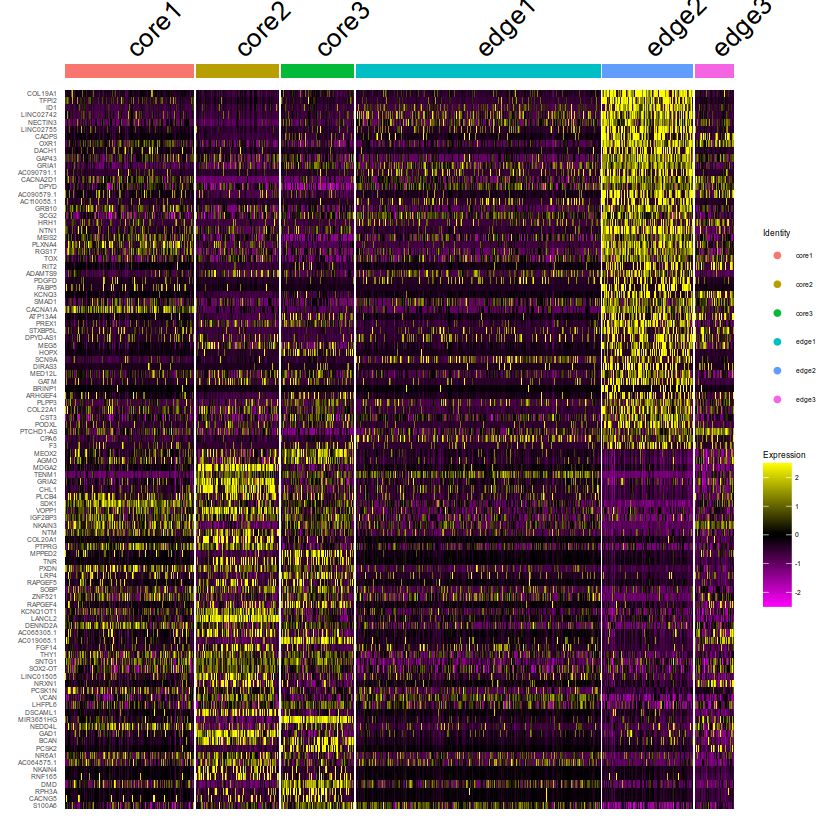

In [62]:
DoHeatmap(alldata, features = as.character(c(top,bottome)), group.by = "sample")+theme(text = element_text(size = 5))

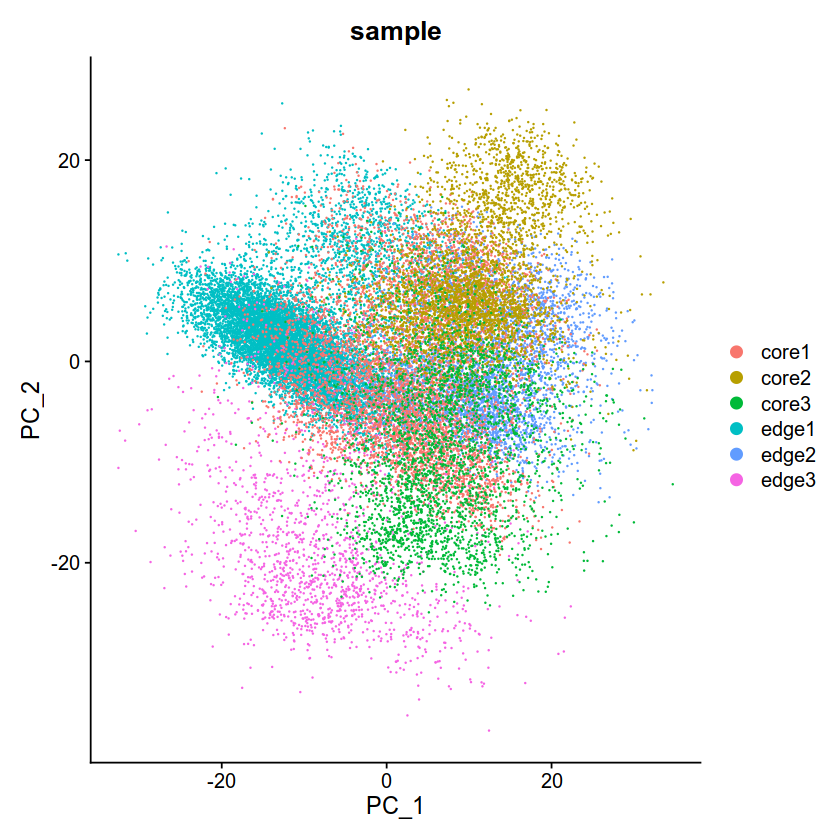

In [63]:
DimPlot(alldata, reduction = "pca", group.by = "sample", dims = 1:2)

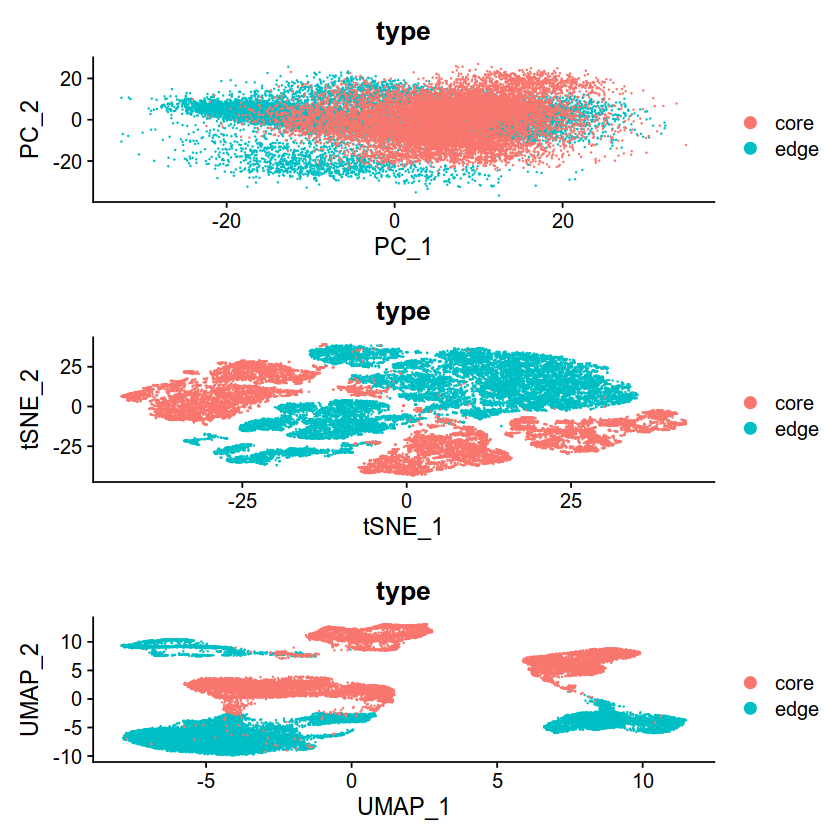

In [64]:
#all
plot_grid(ncol = 1, DimPlot(alldata, reduction = "pca", group.by = "type"),
    DimPlot(alldata, reduction = "tsne", group.by = "type"), DimPlot(alldata,
        reduction = "umap", group.by = "type"))

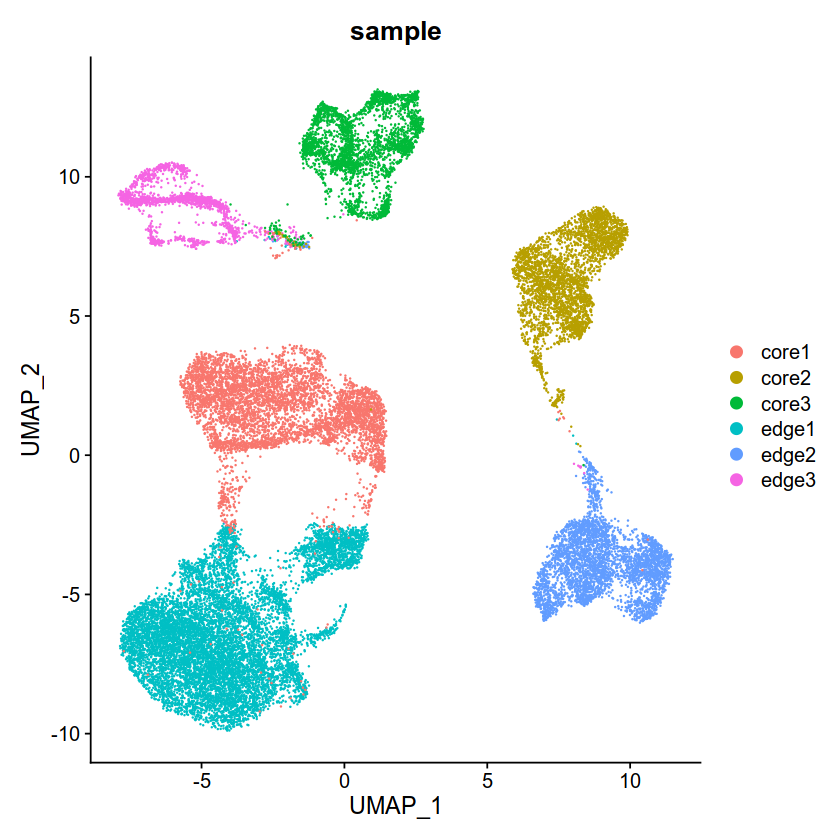

In [65]:
DimPlot(alldata, reduction = "umap", group.by = "sample", dims = 1:2)

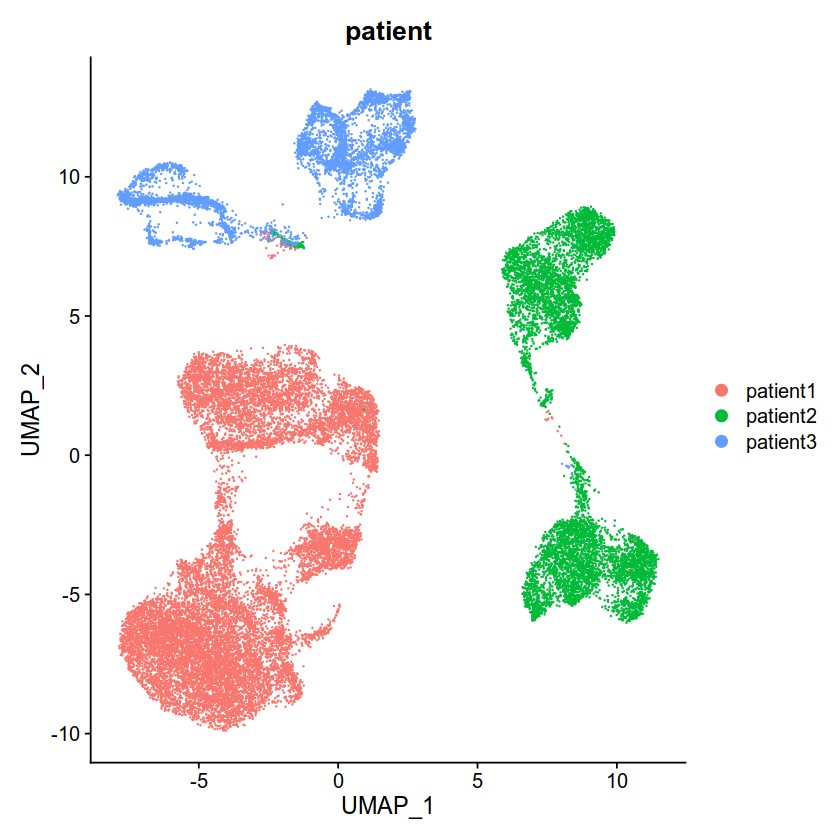

In [66]:
DimPlot(alldata, reduction = "umap", group.by = "patient", dims = 1:2)

In [235]:
#integration 
alldata.list2 <- SplitObject(alldata, split.by = "patient")
alldata.anchors2 <- FindIntegrationAnchors(object.list = alldata.list2, dims = 1:30,
    reduction = "cca")

Computing 2000 integration features

Scaling features for provided objects

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Finding all pairwise anchors

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 25684 anchors

Filtering anchors

	Retained 4806 anchors



R_zmq_msg_send errno: 4 strerror: Interrupted system call


Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 17945 anchors

Filtering anchors

	Retained 3290 anchors



R_zmq_msg_send errno: 4 strerror: Interrupted system call


Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 15203 anchors

Filtering anchors

	Retained 4915 anchors



In [236]:
alldata.int2 <- IntegrateData(anchorset = alldata.anchors2, dims = 1:30, new.assay.name = "CCA")


Merging dataset 3 into 2

Extracting anchors for merged samples

Finding integration vectors

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Finding integration vector weights

Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Integrating data

Merging dataset 2 3 into 1

Extracting anchors for merged samples

Finding integration vectors

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Finding integration vector weights

Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Integrating data



In [237]:
alldata.int2 <- ScaleData(alldata.int2,vars.to.regress=c("CC.Difference","percent_mito","nCount_RNA"),verbose = FALSE)


Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


In [238]:
alldata.int2 <- RunPCA(alldata.int2, npcs = 30, verbose = FALSE)
alldata.int2 <- RunUMAP(alldata.int2, dims = 1:30)

11:24:11 UMAP embedding parameters a = 0.9922 b = 1.112

11:24:11 Read 27670 rows and found 30 numeric columns

11:24:11 Using Annoy for neighbor search, n_neighbors = 30

11:24:11 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:24:14 Writing NN index file to temp file /tmp/Rtmpca9QyS/file939e484b2285

11:24:14 Searching Annoy index using 30 threads, search_k = 3000

11:24:15 Annoy recall = 100%

11:24:17 Commencing smooth kNN distance calibration using 30 threads
 with target n_neighbors = 30

11:24:20 Initializing from normalized Laplacian + noise (using irlba)

11:24:22 Commencing optimization for 200 epochs, with 1225672 positive edges

11:24:38 Optimization finished



In [239]:
alldata.int2 <- RunTSNE(alldata.int2, dims = 1:30,nthreads = 30)

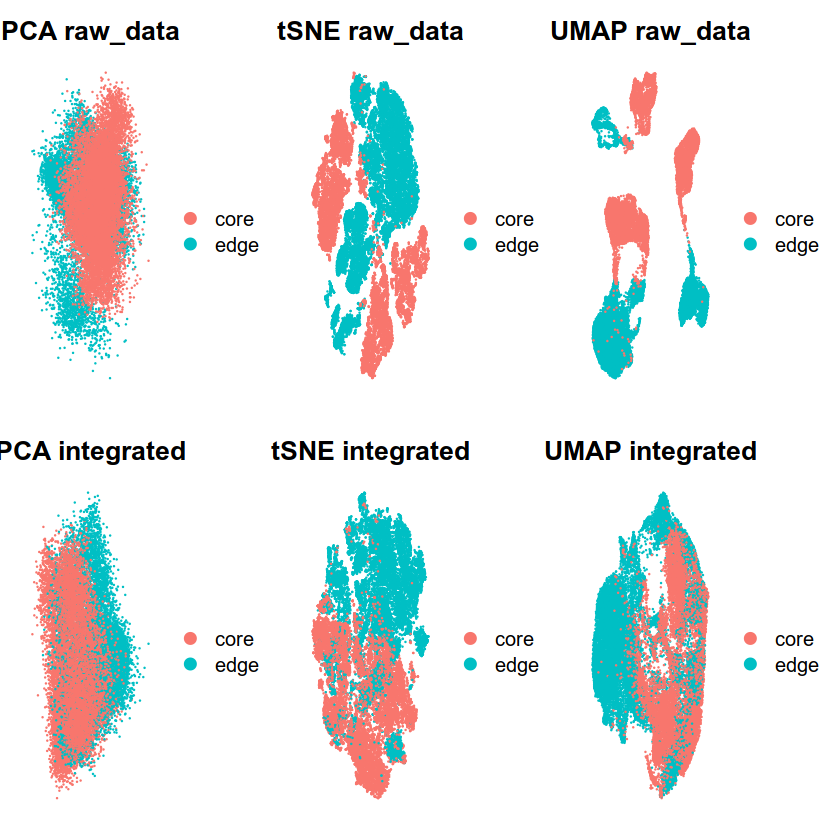

In [240]:
plot_grid(ncol = 3,
  DimPlot(alldata, reduction = "pca", group.by = "type")+NoAxes()+ggtitle("PCA raw_data"),
  DimPlot(alldata, reduction = "tsne", group.by = "type")+NoAxes()+ggtitle("tSNE raw_data"),
  DimPlot(alldata, reduction = "umap", group.by = "type")+NoAxes()+ggtitle("UMAP raw_data"),
  
  DimPlot(alldata.int2, reduction = "pca", group.by = "type")+NoAxes()+ggtitle("PCA integrated"),
  DimPlot(alldata.int2, reduction = "tsne", group.by = "type")+NoAxes()+ggtitle("tSNE integrated"),
  DimPlot(alldata.int2, reduction = "umap", group.by = "type")+NoAxes()+ggtitle("UMAP integrated")
)

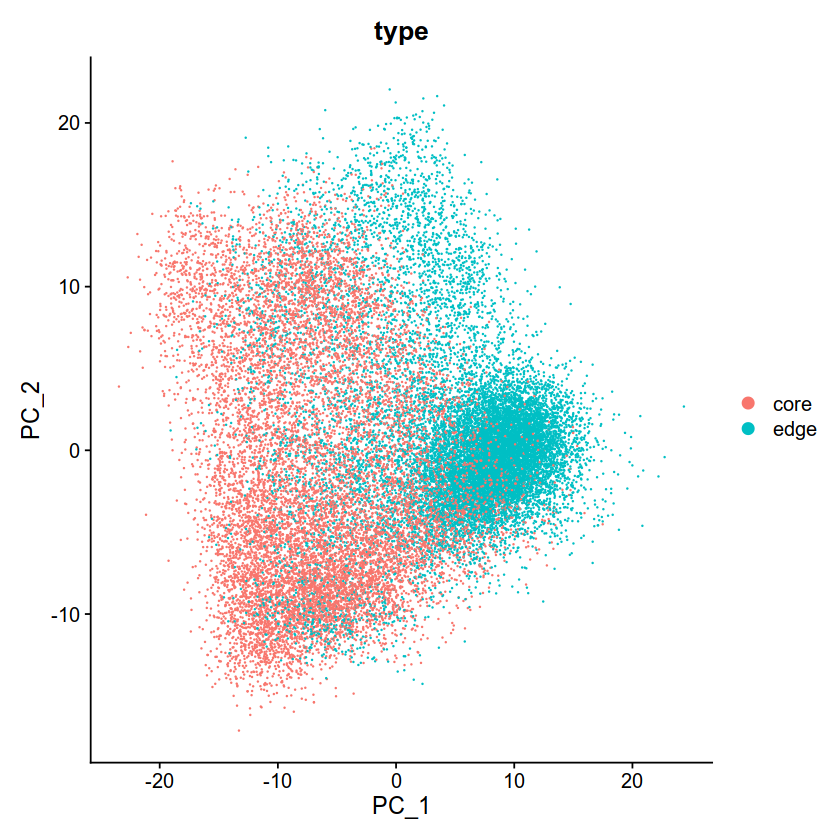

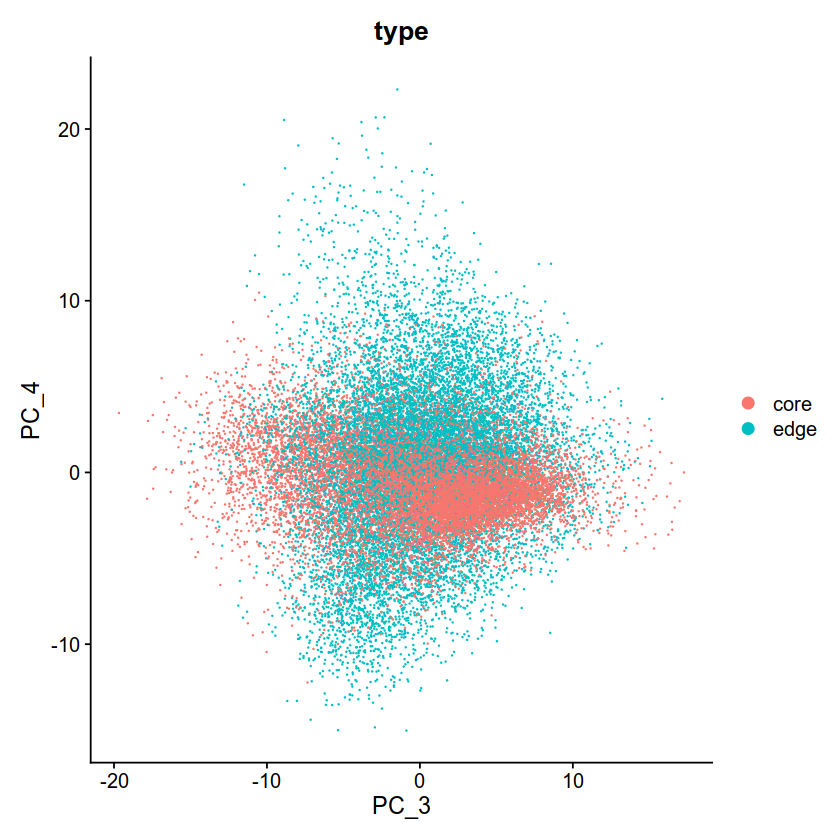

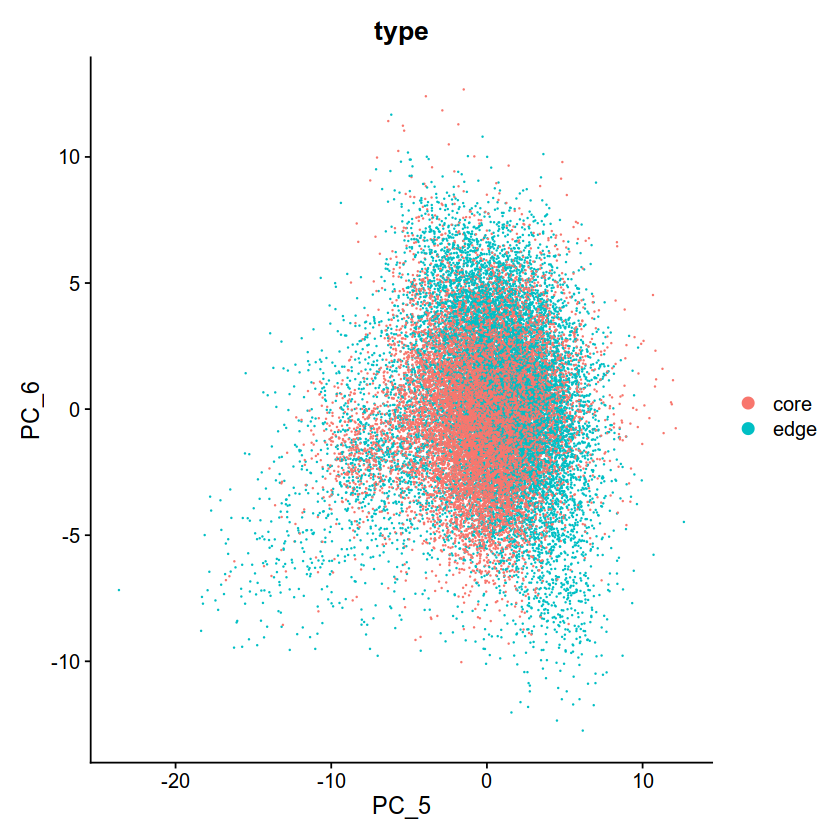

In [241]:
DimPlot(alldata.int2, reduction = "pca", group.by = "type",dims=1:2)
DimPlot(alldata.int2, reduction = "pca", group.by = "type",dims=3:4)
DimPlot(alldata.int2, reduction = "pca", group.by = "type",dims=5:6)


In [242]:
pc.int2 <- data.frame(alldata.int2@reductions$pca@cell.embeddings)

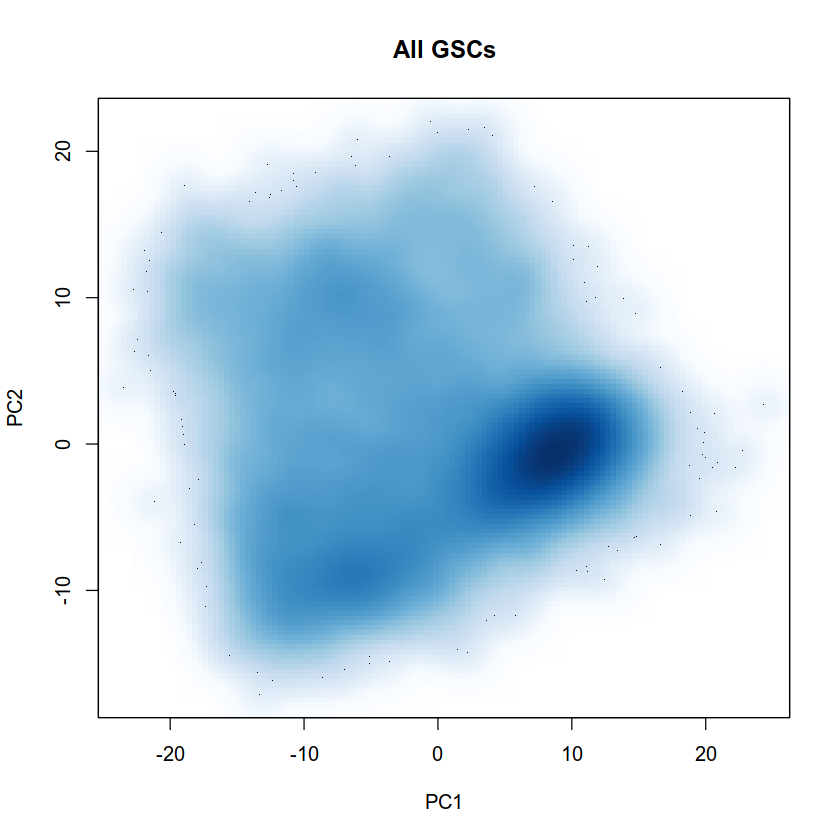

In [243]:
smoothScatter(pc.int2$PC_1, 
     pc.int2$PC_2, 
     cex = 0.3, 
     xlab = "PC1",
     ylab = "PC2",
     main = "All GSCs"
    )


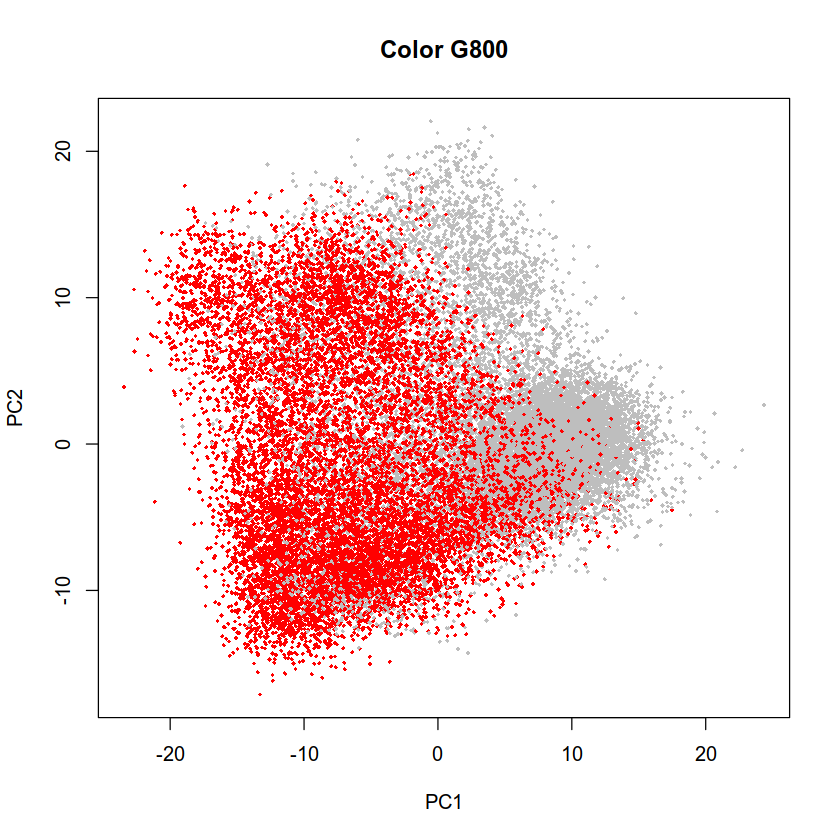

In [244]:
plot(pc.int2$PC_1, 
     pc.int2$PC_2, 
     cex = 0.5, 
     xlab = "PC1",
     ylab = "PC2",
     main = "Color G800",
     col= ifelse(grepl("core", rownames(pc.int2)), "red", "grey"),
     pch = 18
    )

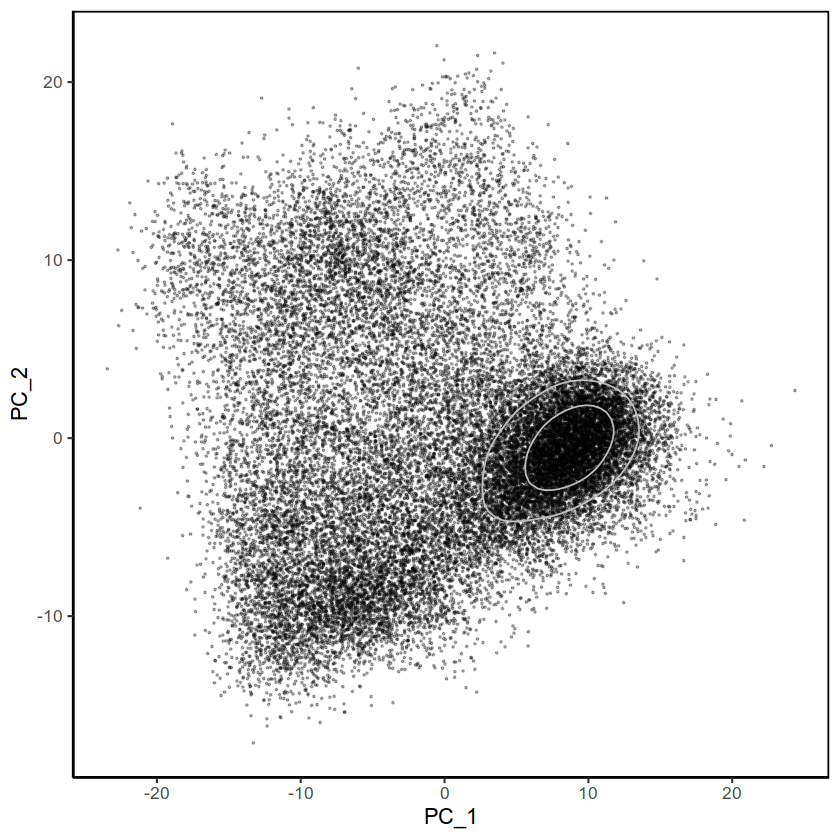

In [245]:
x <- ggplot(pc.int2, aes(PC_1, PC_2)) + geom_point(size=0.4, alpha = 0.3, color = "black") +  
geom_density_2d(bins = 3, color = "grey") + theme_classic(base_size=13) +
 #scale_fill_gradient("Median Raw \nAUC Score", low = "white", high = "red") +
     #scale_fill_viridis("Median Raw \nAUC Score", begin = 0, end = 1) +
theme(panel.border = element_rect(colour = "black", fill=NA, size=1)) 
x


In [246]:
nGenes<-100
pca.int2.genes <- data.frame(alldata.int2@reductions$pca@feature.loadings)

In [247]:
top <- rownames(pca.int2.genes[order(pca.int2.genes$PC_1, decreasing = TRUE), ])[1:nGenes]
bottome<-rownames(pca.int2.genes[order(pca.int2.genes$PC_1,decreasing =F),])[1:nGenes]

In [248]:
write.table(top,file="pc.all.top.edge.list.xls",row.names =F)
write.table(bottome,file="pc.all.top.core.list.xls",row.names =F)


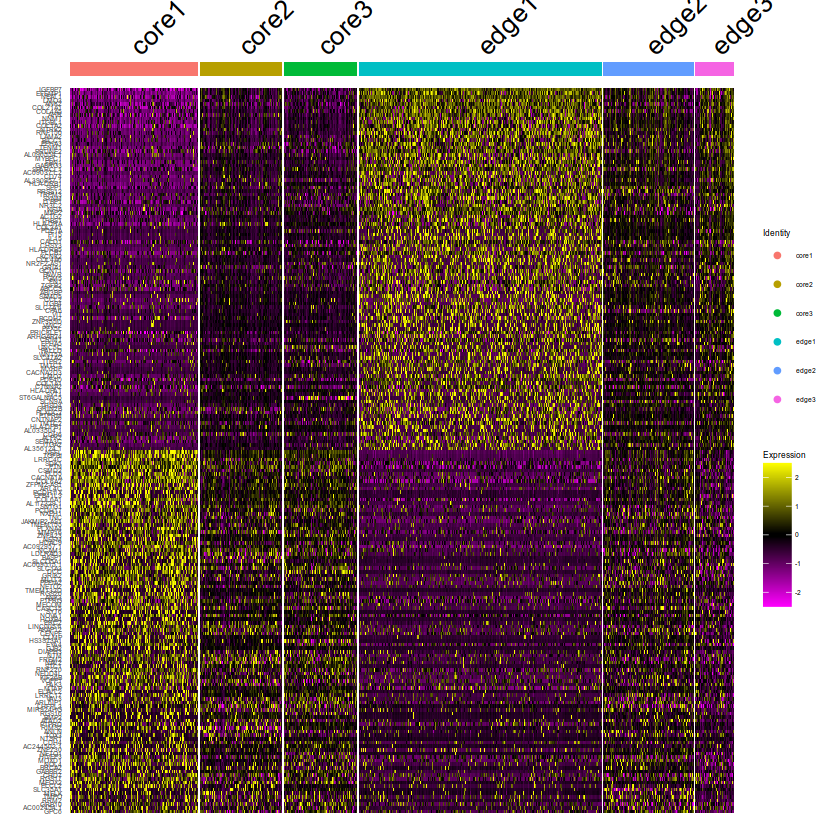

In [249]:
DoHeatmap(alldata.int2, features = as.character(c(top,bottome)), group.by = "sample")+theme(text = element_text(size = 5))

In [250]:
?DoHeatmap

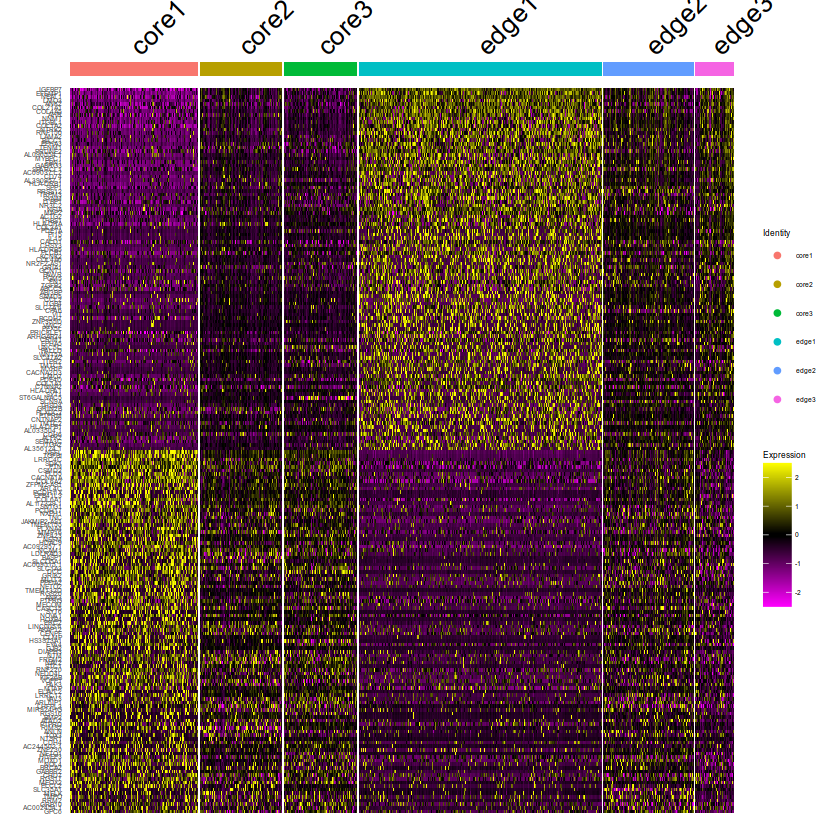

In [251]:
DoHeatmap(alldata.int2, features = as.character(c(top,bottome)), group.by = "sample")+theme(text = element_text(size = 5))

In [252]:
alldata.int2.matrix<-as.matrix(alldata.int2@assays$RNA@data)
cells_rankings <- AUCell_buildRankings(alldata.int2.matrix, nCores=30, plotStats=FALSE)
#calculate enrichment for the gene signatures
geneSets <- GeneSet(c(top), setName="geneSet1")
cells_AUC <- AUCell_calcAUC(geneSets, cells_rankings)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 5.7 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."


,threshold,nCells
Global_k1,0.3084737,8743
L_k2,0.2983526,9031
R_k3,0.2243446,10245
minimumDens,0.2474684,9933


minimumDens 
  0.2474684

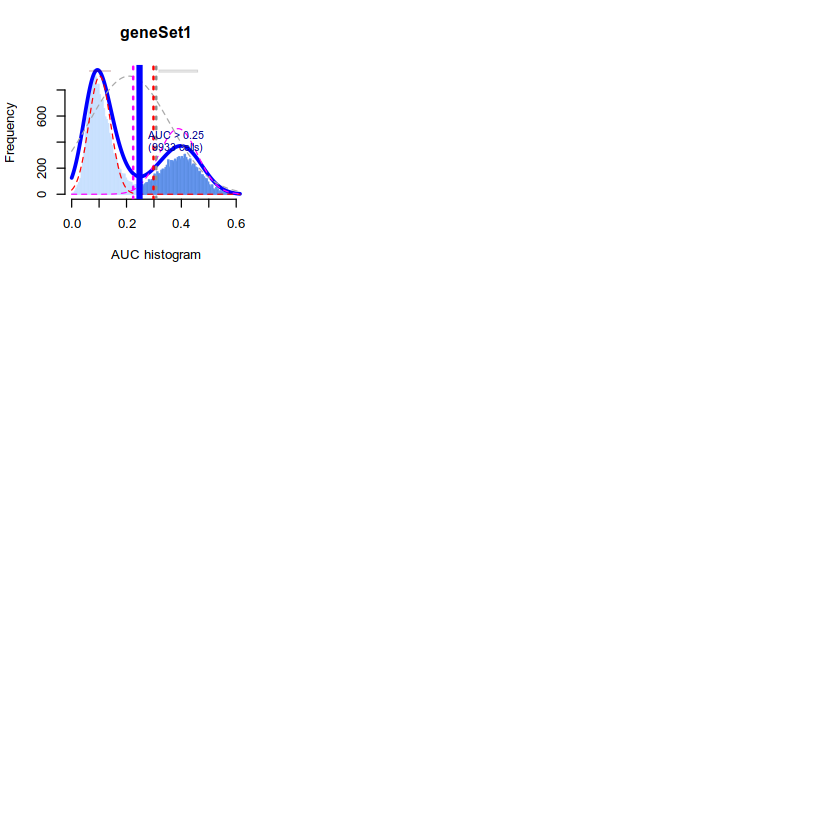

In [253]:
#Determine the cells with the given gene signatures or active gene sets
par(mfrow=c(3,3)) 
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, assign=TRUE) 
cells_assignment$geneSet1$aucThr$thresholds
cells_assignment$geneSet1$aucThr$selected

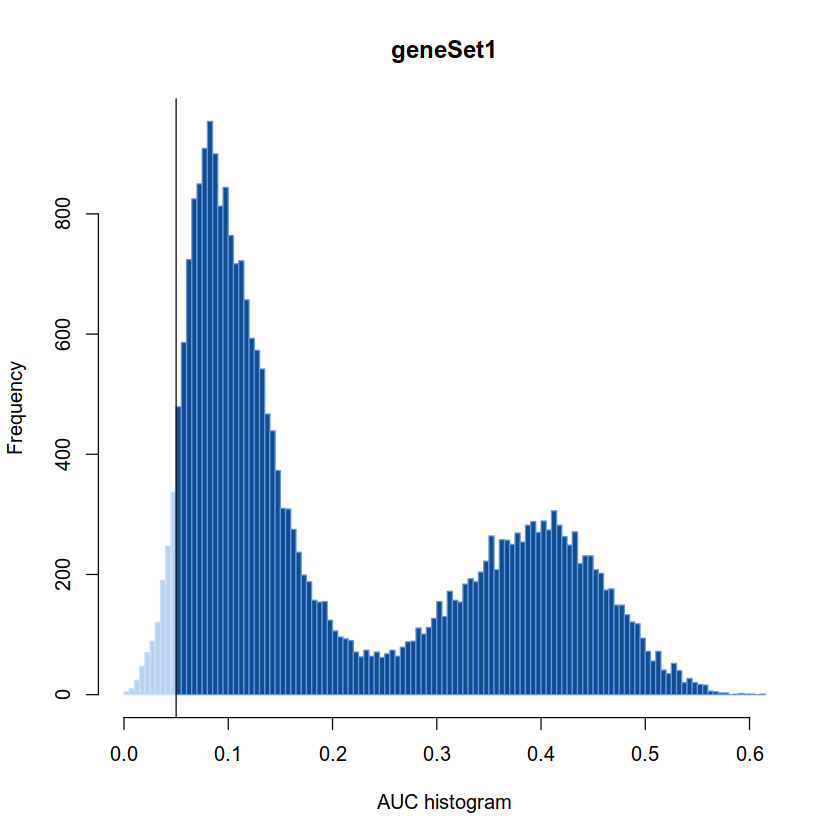

In [254]:
#ploting
geneSetName<-rownames(cells_AUC)[grep("geneSet1", rownames(cells_AUC))]
AUCell_plotHist(cells_AUC[geneSetName,], aucThr=0.05)
abline(v=0.05)

In [255]:
edge_AUC<-data.frame(t(as.data.frame(cells_AUC@assays@data$AUC)))
colnames(edge_AUC)<-"AUC"
#add AU#add AU"C
alldata.int2<-AddMetaData(alldata.int2,metadata=edge_AUC)
alldata.int2$edge_AUC = edge_AUC

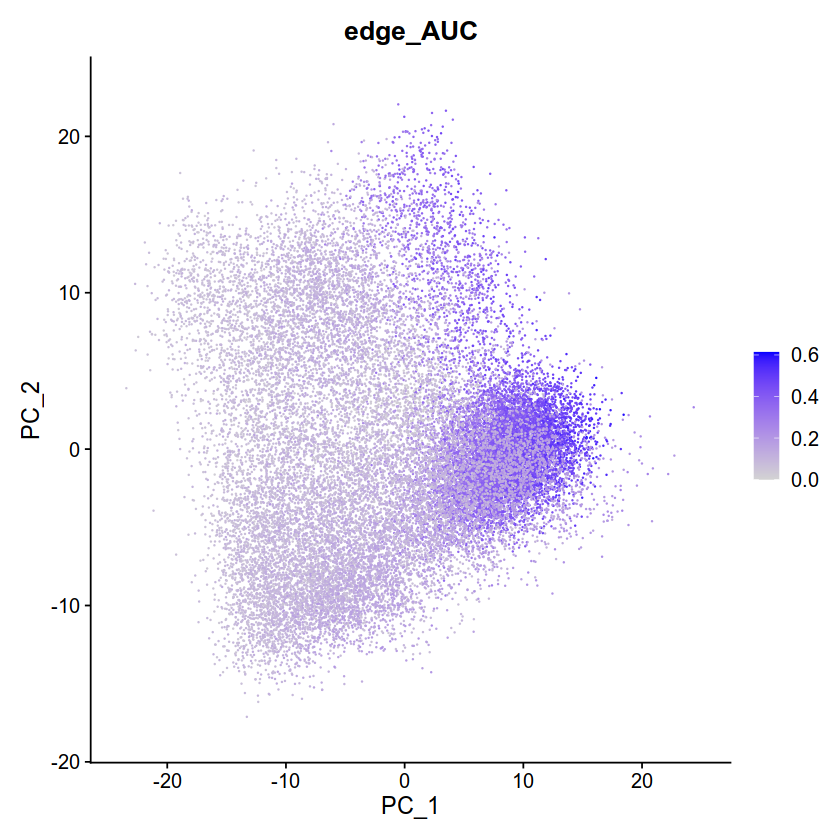

In [256]:
FeaturePlot(alldata.int2, features = 'edge_AUC',reduction="pca")

In [257]:
alldata.int2.matrix<-as.matrix(alldata.int2@assays$RNA@data)
cells_rankings <- AUCell_buildRankings(alldata.int2.matrix, nCores=30, plotStats=FALSE)
#calculate enrichment for the gene signatures
geneSets <- GeneSet(c(bottome), setName="geneSet1")
cells_AUC <- AUCell_calcAUC(geneSets, cells_rankings)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 5.7 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."


,threshold,nCells
Global_k1,0.2539024,5803
L_k2,0.7515073,0
R_k3,0.2696571,4809
minimumDens,0.1301528,16968


minimumDens 
  0.1301528

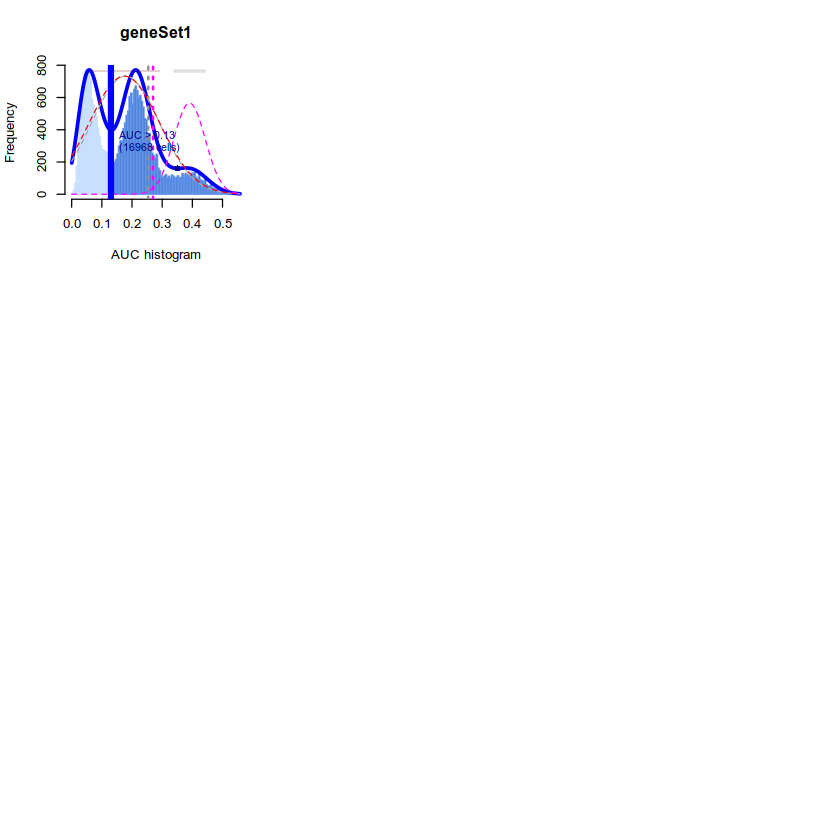

In [258]:
#Determine the cells with the given gene signatures or active gene sets
par(mfrow=c(3,3)) 
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, assign=TRUE) 
cells_assignment$geneSet1$aucThr$thresholds
cells_assignment$geneSet1$aucThr$selected

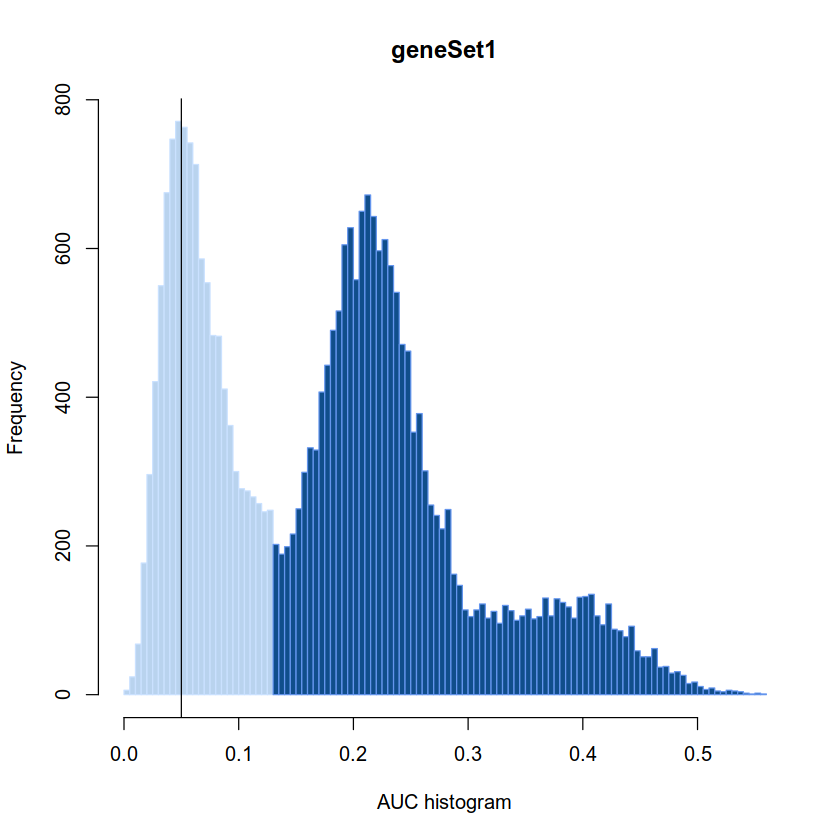

In [259]:
#ploting
geneSetName<-rownames(cells_AUC)[grep("geneSet1", rownames(cells_AUC))]
AUCell_plotHist(cells_AUC[geneSetName,], aucThr=0.13)
abline(v=0.05)

In [260]:
core_AUC<-data.frame(t(as.data.frame(cells_AUC@assays@data$AUC)))
colnames(core_AUC)<-"AUC"
#add AU#add AU"C
alldata.int2<-AddMetaData(alldata.int2,metadata=core_AUC)
alldata.int2$core_AUC = core_AUC

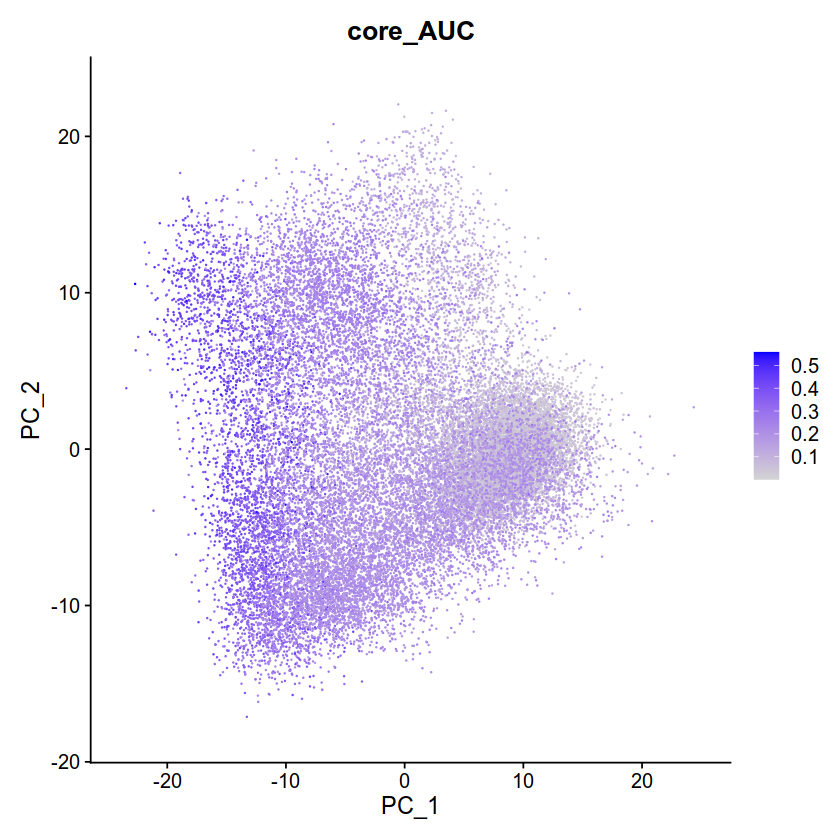

In [261]:



FeaturePlot(alldata.int2, features = 'core_AUC',reduction="pca")

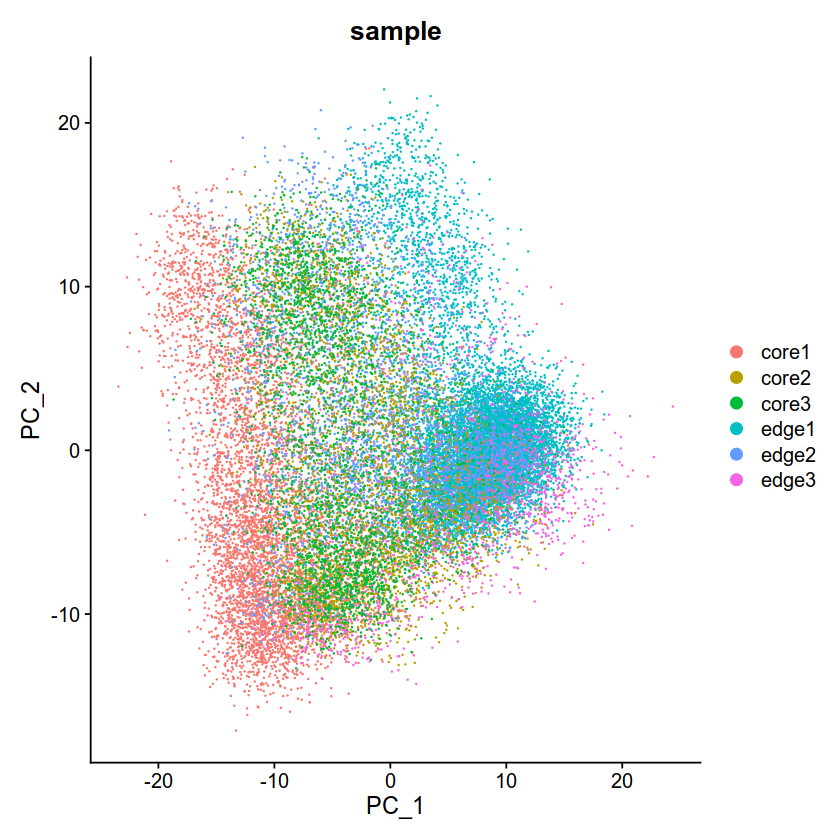

In [262]:
DimPlot(alldata.int2, reduction = "pca", group.by = "sample", dims = 1:2)

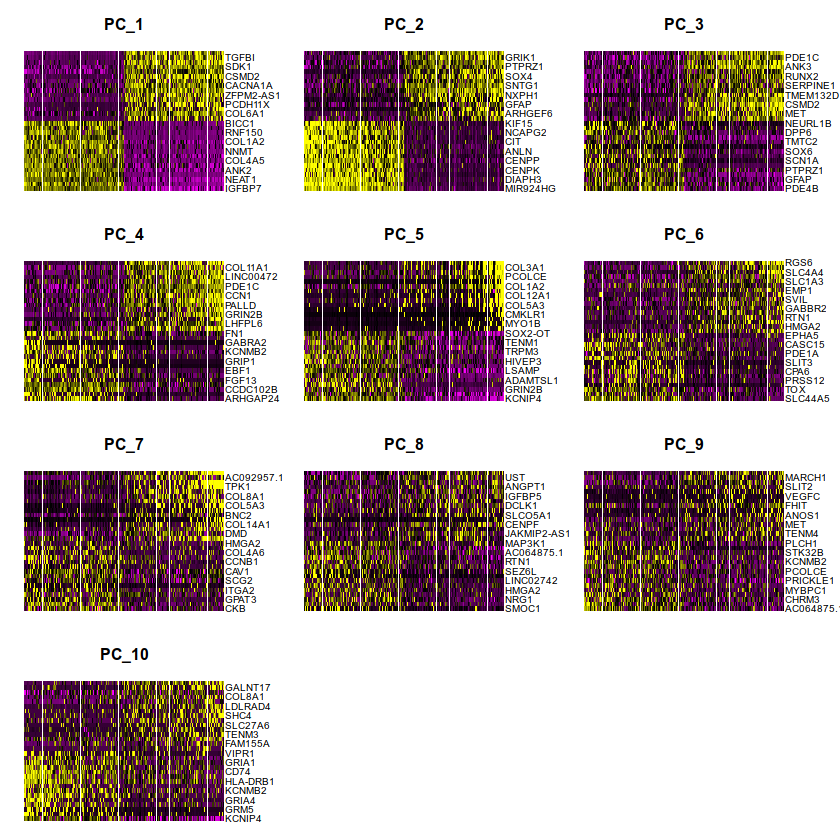

In [263]:
DimHeatmap(alldata.int2, dims = 1:10, cells = 5000, balanced = TRUE)

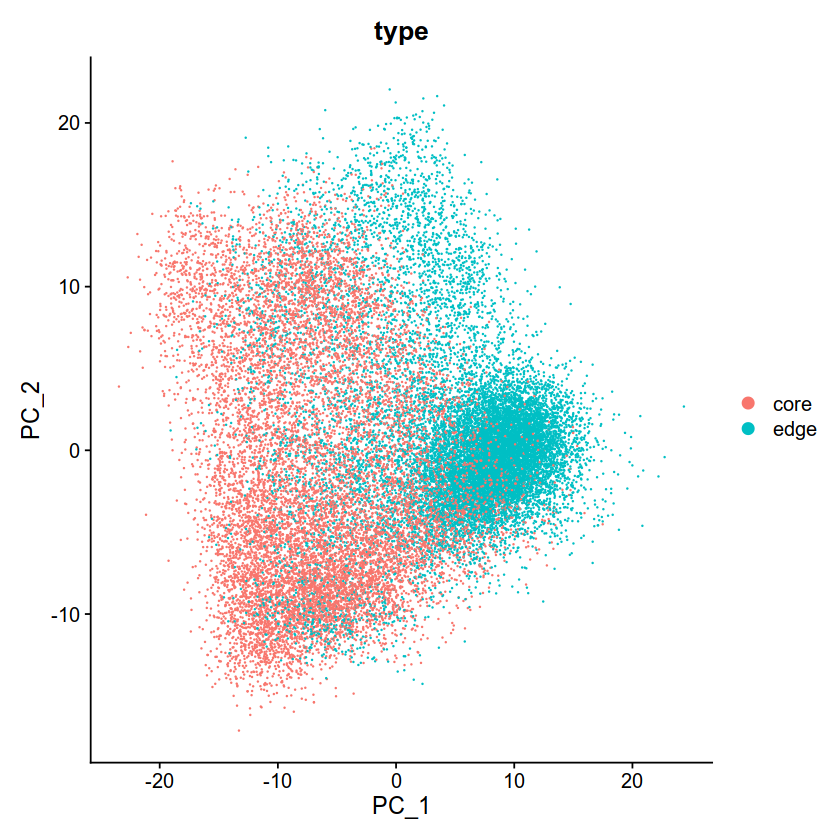

In [264]:
DimPlot(alldata.int2, reduction = "pca", group.by = "type",dims=1:2)

In [265]:
cluster<-read.table("/disk1/xilu/glioblastoma_single_cell/2.ATAC/2.single_cell_snapatac_all/merged_cluster/fame.atac.seq.cluser.scRNA-seq.merged.xls",header=T,sep="\t")
colnames(cluster)<-c("file_barcode","ATAC")
cluster2<-data.frame(cluster[,2])
rownames(cluster2)<-cluster[,1]
alldata.int2<-AddMetaData(alldata.int2,metadata=cluster2)
alldata.int2$ATAC<-cluster2


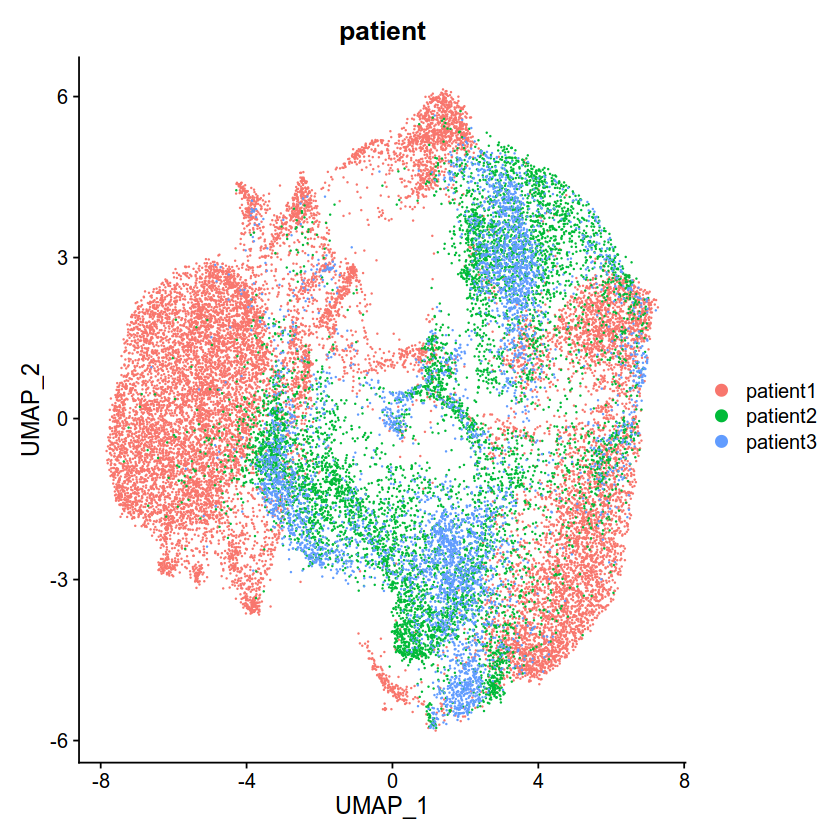

In [266]:
DimPlot(alldata.int2, reduction = "umap", group.by = "patient",dims=1:2)

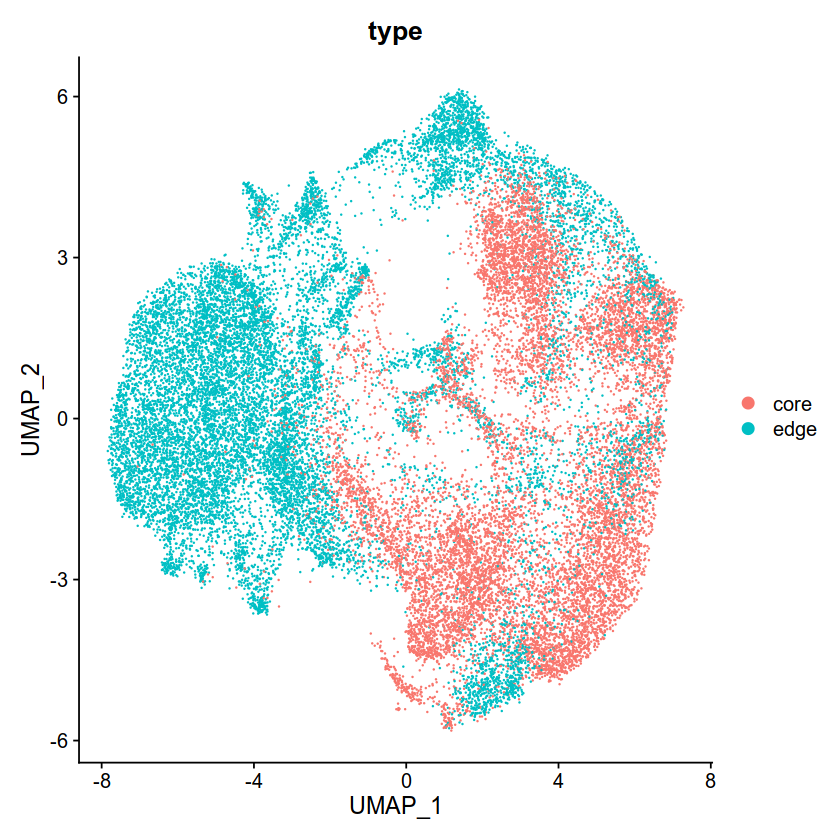

In [267]:
DimPlot(alldata.int2, reduction = "umap", group.by = "type",dims=1:2)

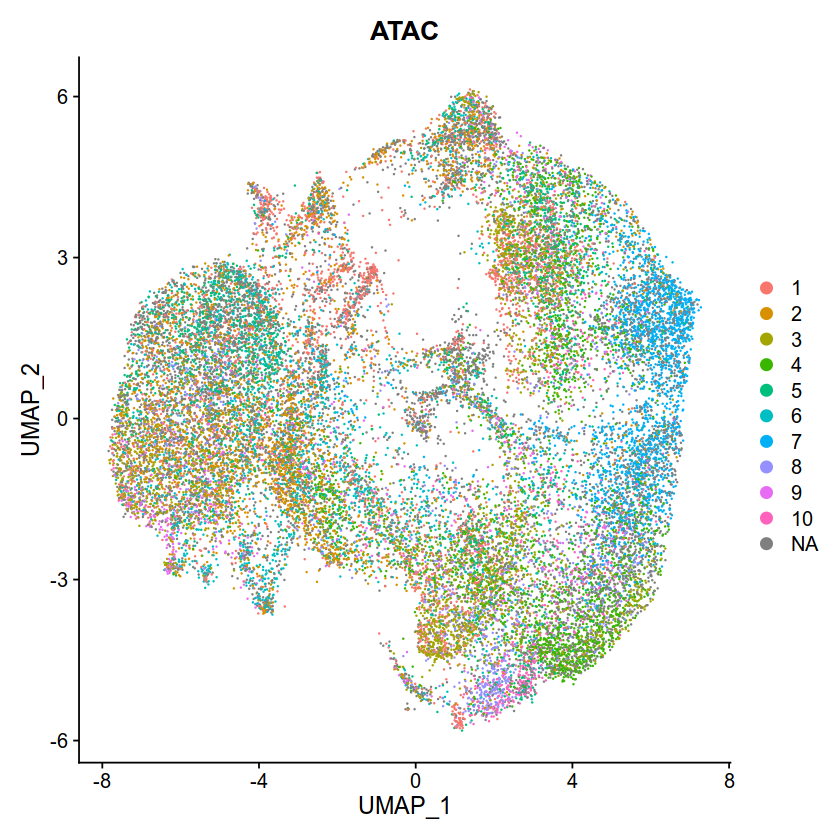

In [268]:
DimPlot(alldata.int2, reduction = "umap", group.by = "ATAC",dims=1:2)

In [269]:
write.table(VariableFeatures(object = alldata.int2),file="variable.features.xls",quote=F,sep="\t",row.names=F)

In [270]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA"

In [271]:
library(harmony)
alldata.harmony <- RunHarmony(alldata, group.by.vars = "patient", reduction = "pca",
    dims.use = 1:50, assay.use = "RNA")

Harmony 1/10

Harmony 2/10

Harmony converged after 2 iterations

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.RNA.harmony; see ?make.names for more details on syntax validity"


In [272]:
#alldata.int[["harmony"]] <- alldata.harmony[["harmony"]]
alldata.harmony <- RunUMAP(alldata.harmony, dims = 1:50, reduction = "harmony", reduction.name = "umap_harmony")



11:32:18 UMAP embedding parameters a = 0.9922 b = 1.112

11:32:18 Read 27670 rows and found 50 numeric columns

11:32:18 Using Annoy for neighbor search, n_neighbors = 30

11:32:18 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:32:21 Writing NN index file to temp file /tmp/Rtmpca9QyS/file939e35e005cd

11:32:21 Searching Annoy index using 30 threads, search_k = 3000

11:32:21 Annoy recall = 100%

11:32:23 Commencing smooth kNN distance calibration using 30 threads
 with target n_neighbors = 30

11:32:26 Initializing from normalized Laplacian + noise (using irlba)

11:32:28 Commencing optimization for 200 epochs, with 1174584 positive edges

11:32:43 Optimization finished

Warning message:
"Cannot add objects with duplicate keys (offending key: UMAP_), setting key to

In [273]:
p1 <- DimPlot(alldata, reduction = "umap", group.by = "type") + ggtitle("UMAP raw_data")
p2 <- DimPlot(alldata.int2, reduction = "umap", group.by = "type") + ggtitle("UMAP CCA")
p3 <- DimPlot(alldata.harmony, reduction = "umap_harmony", group.by = "type") +
    ggtitle("UMAP Harmony")

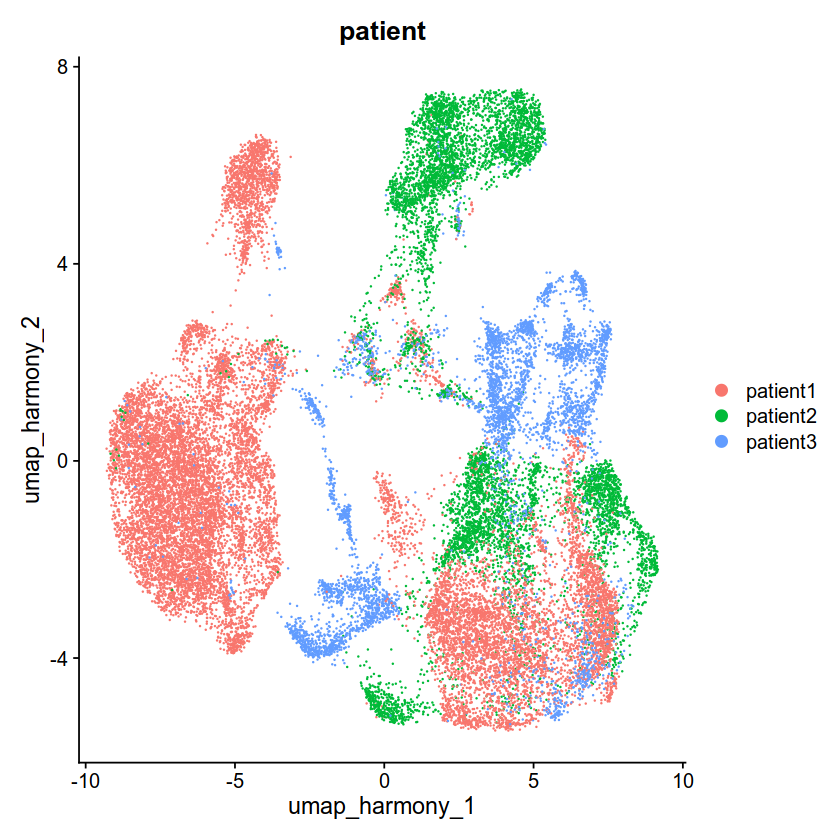

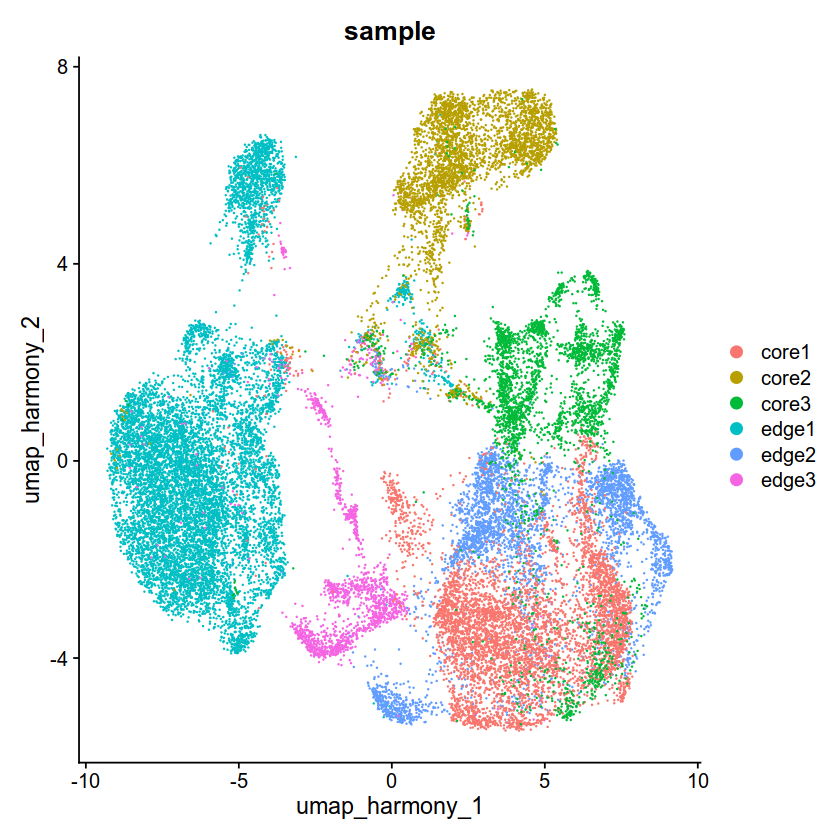

In [275]:
DimPlot(alldata.harmony, reduction = "umap_harmony", group.by = "patient")
DimPlot(alldata.harmony, reduction = "umap_harmony", group.by = "sample")


In [276]:
cluster<-read.table("/disk1/xilu/glioblastoma_single_cell/2.ATAC/2.single_cell_snapatac_all/merged_cluster/fame.atac.seq.cluser.scRNA-seq.merged.xls",header=T,sep="\t")
colnames(cluster)<-c("file_barcode","ATAC")
cluster2<-data.frame(cluster[,2])
rownames(cluster2)<-cluster[,1]
alldata.harmony<-AddMetaData(alldata.harmony,metadata=cluster2)
alldata.harmony$ATAC<-cluster2

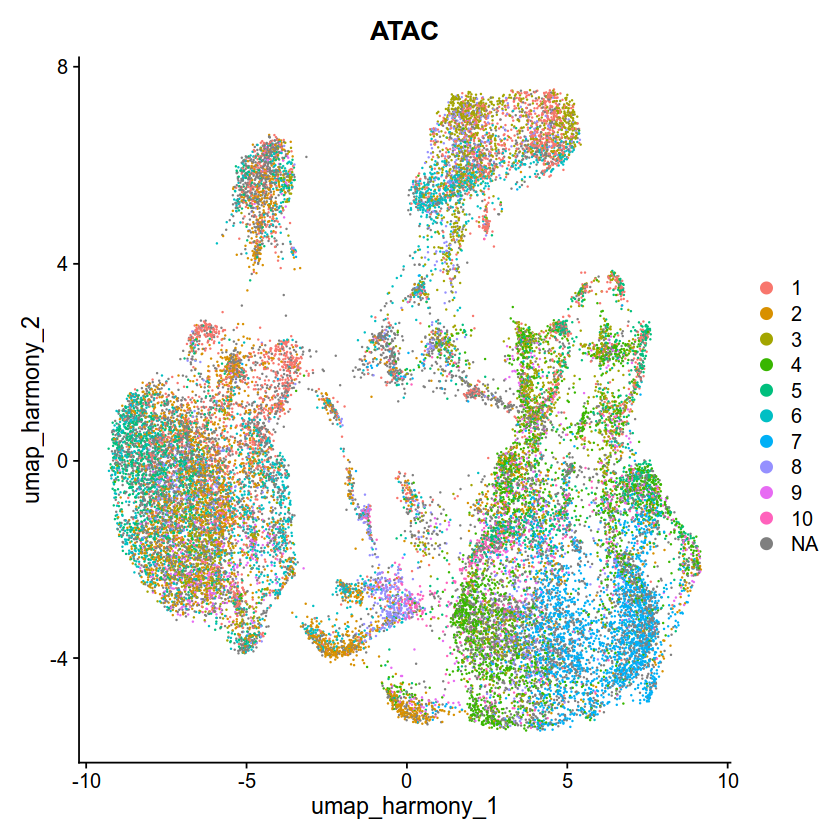

In [277]:
DimPlot(alldata.harmony, reduction = "umap_harmony", group.by = "ATAC")

In [278]:
alldata.int<-alldata.int2

In [279]:
#build gene-expression rankings for each cell 
glio.int.matrix<-as.matrix(alldata.int@assays$RNA@data)
cells_rankings <- AUCell_buildRankings(glio.int.matrix, nCores=30, plotStats=FALSE)
#calculate enrichment for the gene signatures
geneSets <- GeneSet(c(s_genes,g2m_genes), setName="geneSet1")
cells_AUC <- AUCell_calcAUC(geneSets, cells_rankings)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 5.7 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."


,threshold,nCells
tenPercentOfMax,0.03656435,8883
Global_k1,0.08107747,5519
L_k2,0.04479381,8147


Global_k1 
0.08107747

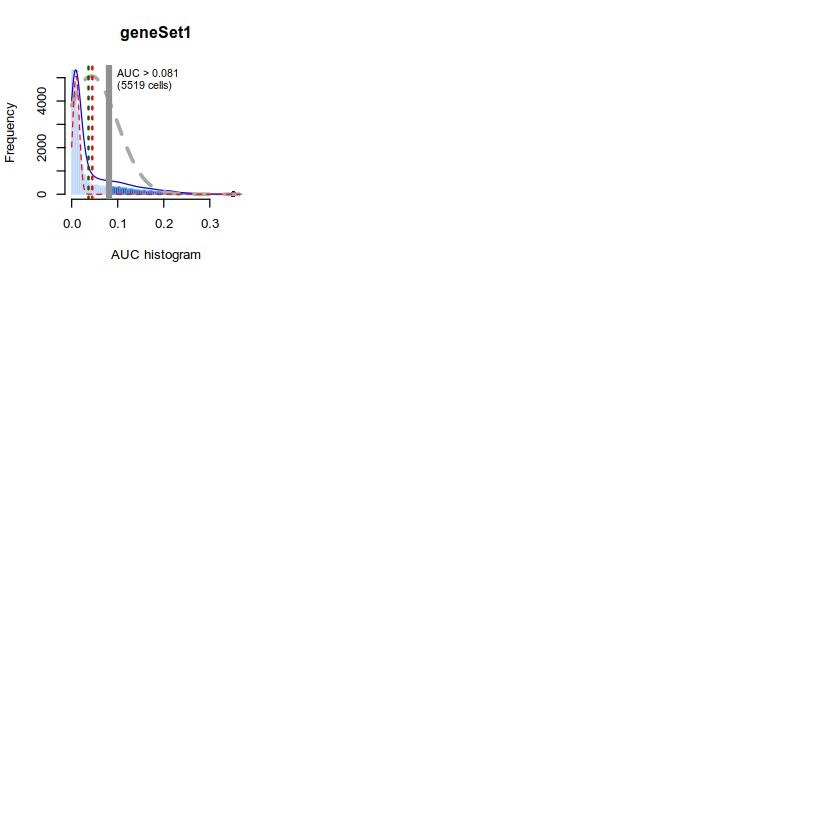

In [280]:
#Determine the cells with the given gene signatures or active gene sets
par(mfrow=c(3,3)) 
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, assign=TRUE) 
cells_assignment$geneSet1$aucThr$thresholds
cells_assignment$geneSet1$aucThr$selected

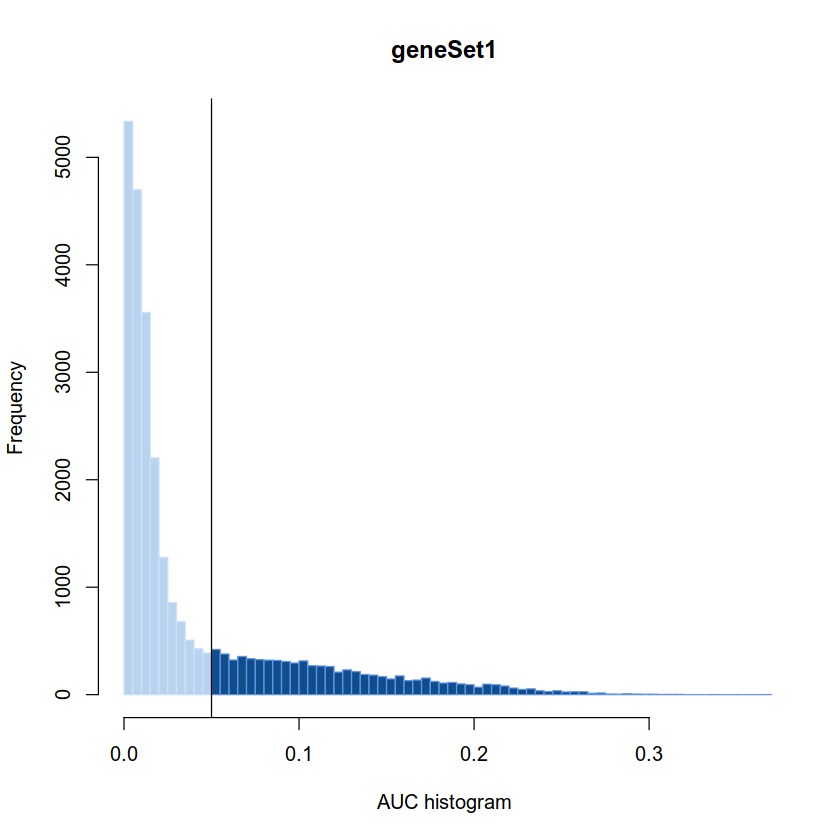

In [281]:
#ploting
geneSetName<-rownames(cells_AUC)[grep("geneSet1", rownames(cells_AUC))]
AUCell_plotHist(cells_AUC[geneSetName,], aucThr=0.05)
abline(v=0.05)

In [282]:
AUC<-data.frame(t(as.data.frame(cells_AUC@assays@data$AUC)))
colnames(AUC)<-"AUC"
#add AU#add AU"C
alldata.int<-AddMetaData(alldata.int,metadata=AUC)
alldata.int$S_G2M_AUC = AUC

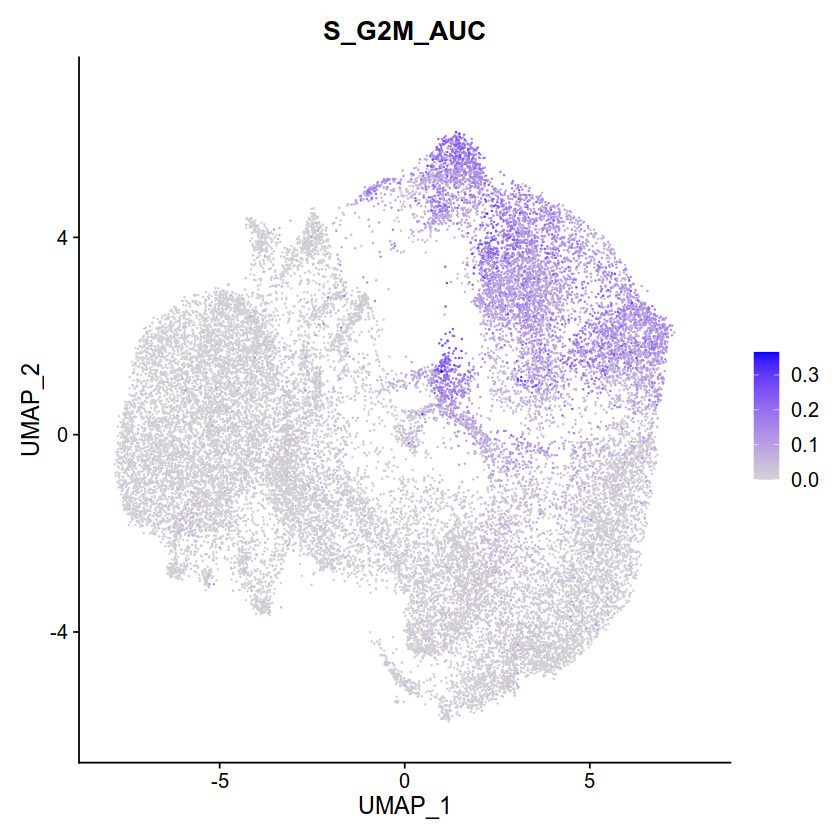

In [283]:
FeaturePlot(alldata.int, features = 'S_G2M_AUC',reduction="umap")

In [284]:
alldata.int<-FindNeighbors(alldata.int,dims=1:30,k.param=60,prune.SNN=1/20)
#filtered_seurat<-FindNeighbors(filtered_seurat,dims=1:30)
names(alldata.int@graphs)



Computing nearest neighbor graph

Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Computing SNN



[1] "CCA_nn"  "CCA_snn"

In [285]:
for( res in c(0.1,0.2,0.3,0.4,0.6,0.8,1)){
    alldata.int<-FindClusters(alldata.int,graph.name='CCA_snn',resolution=res,algorithm=1)
    #filtered_seurat<-FindClusters(filtered_seurat,resolution=res)
}

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 27670
Number of edges: 4125599

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9358
Number of communities: 3
Elapsed time: 16 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 27670
Number of edges: 4125599

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9072
Number of communities: 6
Elapsed time: 18 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 27670
Number of edges: 4125599

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8865
Number of communities: 7
Elapsed time: 15 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 27670
Number of edges: 4125599

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8684
Number of communities: 8
Elapsed time: 17 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 27670
Number of edges: 4125599

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8394
Number of communities: 12
Elapsed time: 19 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 27670
Number of edges: 4125599

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8194
Number of communities: 14
Elapsed time: 18 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 27670
Number of edges: 4125599

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8011
Number of communities: 14
Elapsed time: 16 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


In [286]:
library(RColorBrewer)
n <- 20
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
col<-sample(col_vector, n)


In [339]:
save(alldata.int,file='glio_RNA.all.merged.cluster.rna.Rdata')

In [290]:
#load("/disk1/xilu/glioblastoma_single_cell/1.RNA/glio_RNA.all.merged.cluster.Rdata")

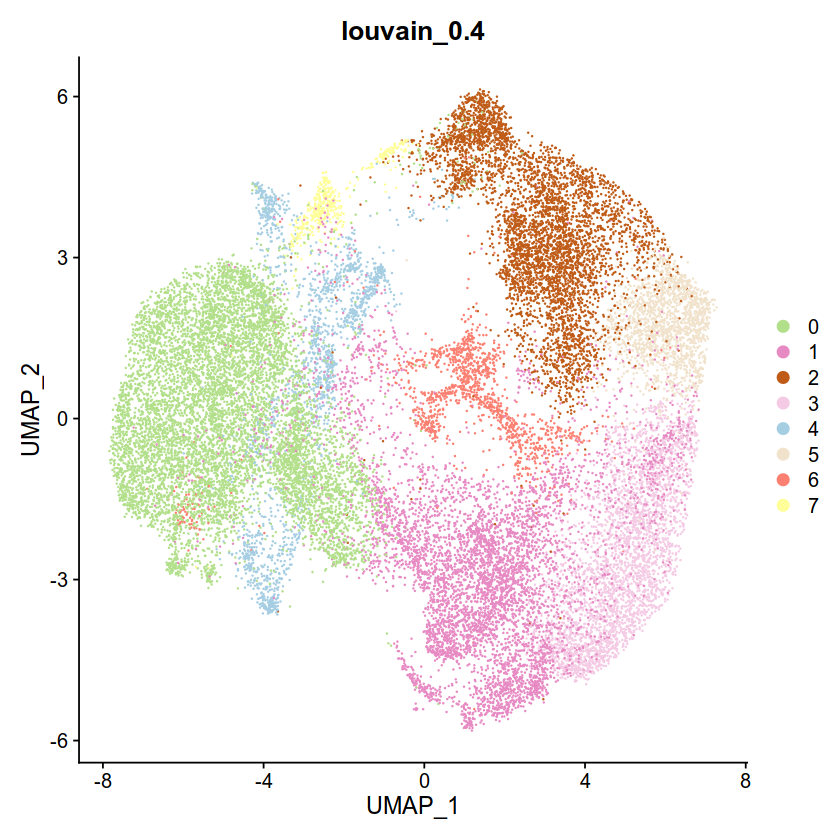

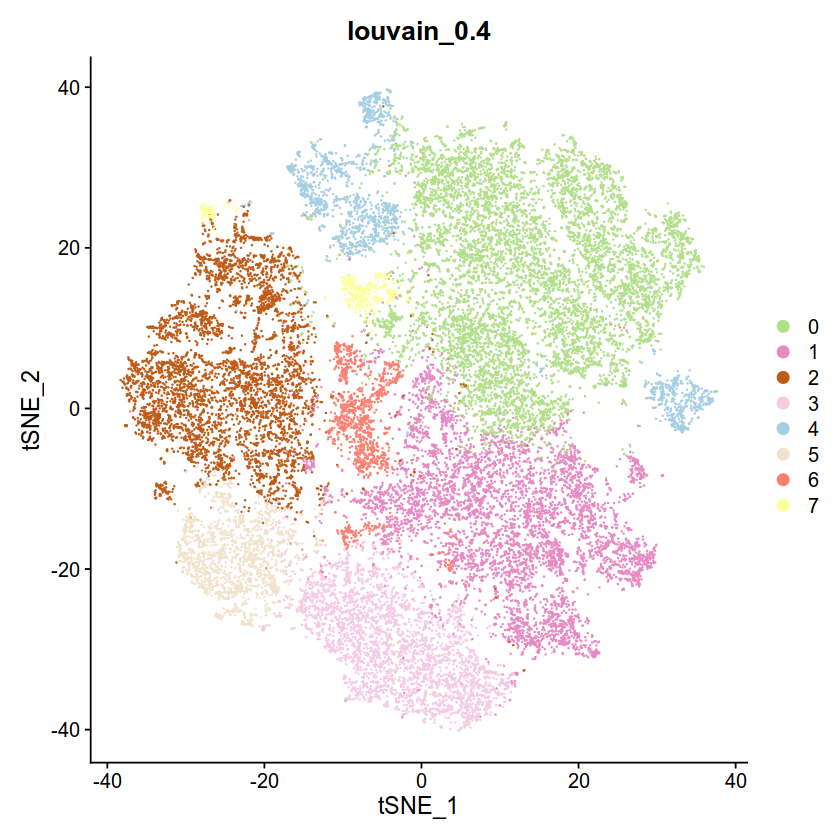

In [291]:
DimPlot(alldata.int, reduction = "umap", group.by = "CCA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
DimPlot(alldata.int, reduction = "tsne", group.by = "CCA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")

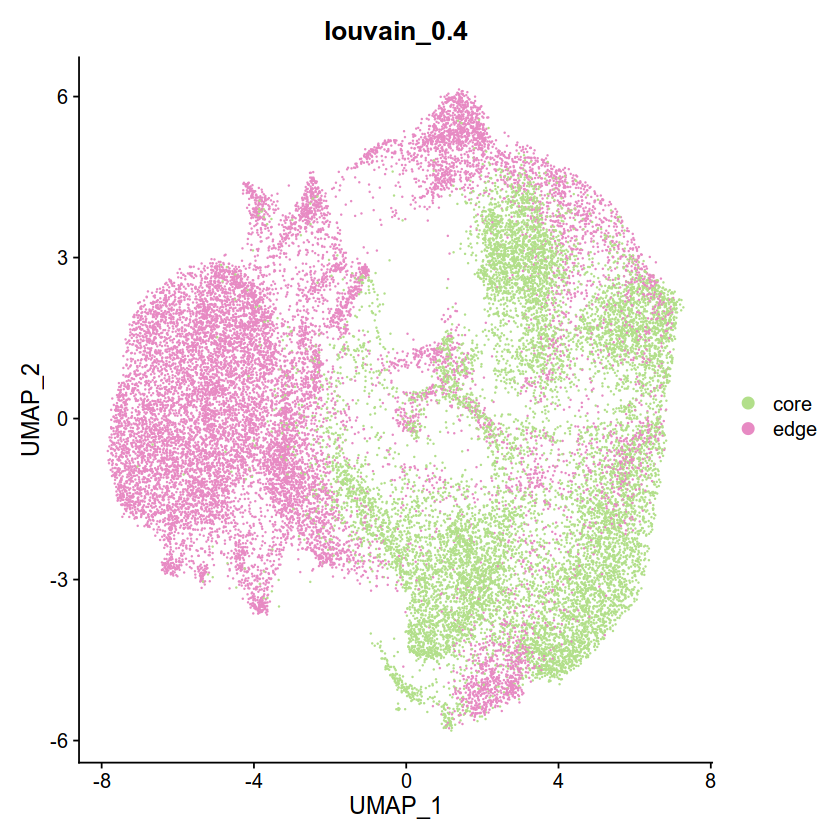

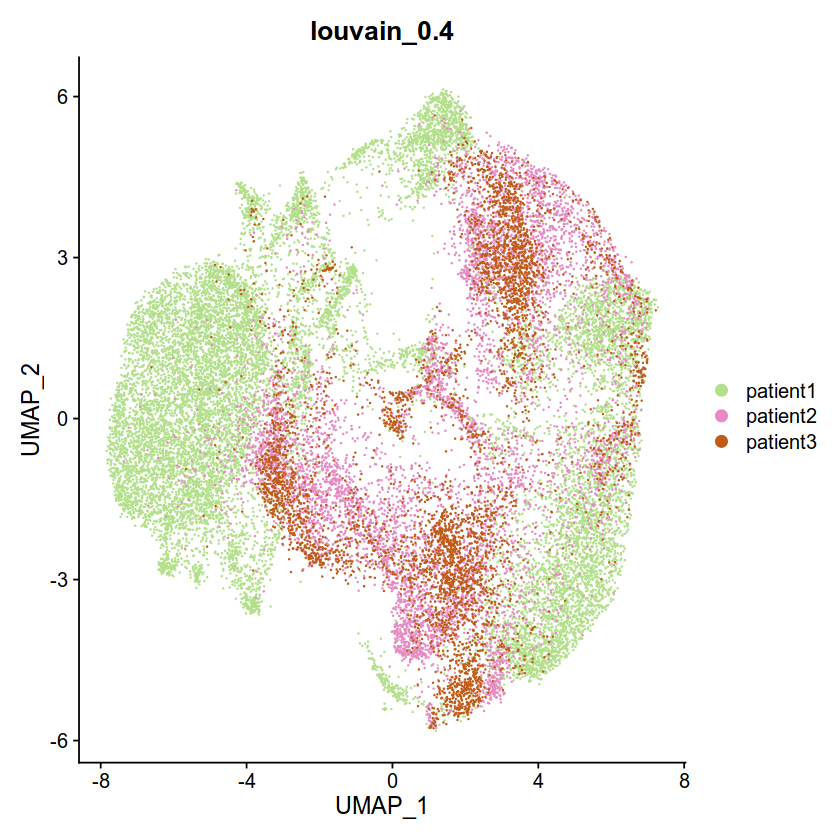

In [292]:
DimPlot(alldata.int, reduction = "umap", group.by = "type",cols = col) + ggtitle("louvain_0.4")
DimPlot(alldata.int, reduction = "umap", group.by = "patient",cols = col) + ggtitle("louvain_0.4")


In [293]:
# length(alldata.int$sample2)

In [294]:
write.table(alldata.int$CCA_snn_res.0.4,file="scRNA-seq.name.cluster.xls",sep="\t",quote=F)

In [295]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA"

In [296]:
cluster<-read.table("/disk1/xilu/glioblastoma_single_cell/2.ATAC/2.single_cell_snapatac_all/merged_cluster/fame.atac.seq.cluser.scRNA-seq.merged.xls",header=T,sep="\t")
colnames(cluster)<-c("file_barcode","ATAC")
cluster2<-data.frame(cluster[,2])
rownames(cluster2)<-cluster[,1]
alldata.int<-AddMetaData(alldata.int,metadata=cluster2)


In [297]:
alldata.int$ATACseq<-cluster2

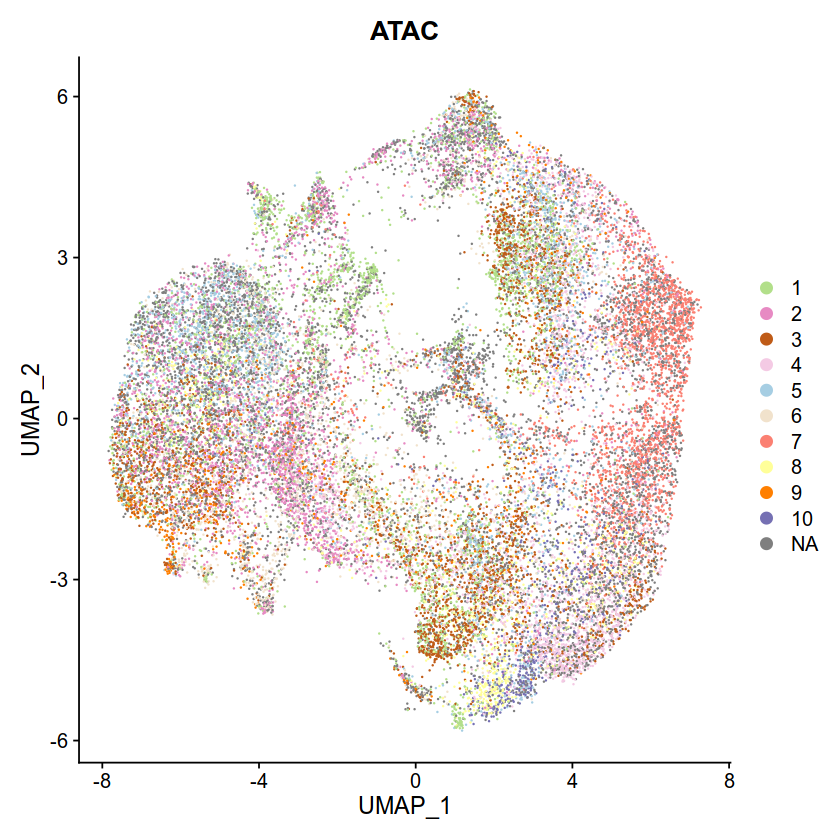

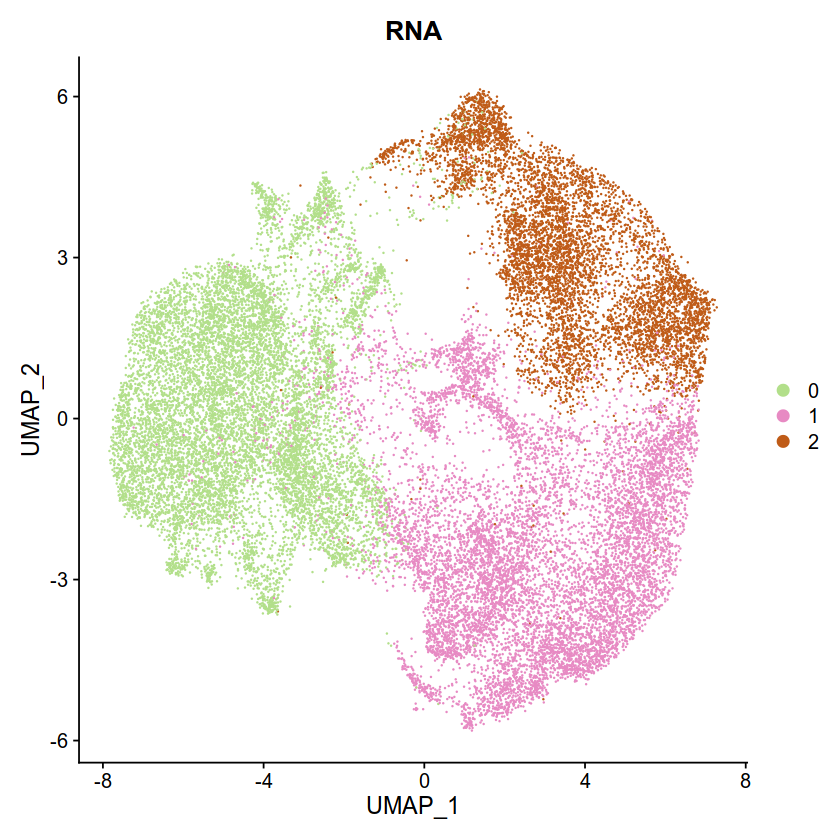

In [298]:
DimPlot(alldata.int, reduction = "umap", group.by = "ATACseq",cols = col) + ggtitle("ATAC")
DimPlot(alldata.int, reduction = "umap", group.by = "CCA_snn_res.0.1",cols = col) + ggtitle("RNA")


In [299]:
table(alldata.int$ATACseq,alldata.int$`CCA_snn_res.0.1`)

    
        0    1    2
  1  1426  735  792
  2  2208  253  381
  3   766 1337  643
  4   310 1470  746
  5  1172  538  575
  6  1396  501  258
  7    45  999 1080
  8   315  795  180
  9   456  157  141
  10    9  508  132

In [300]:
table(alldata.int$sample,alldata.int$`CCA_snn_res.0.1`)

       
           0    1    2
  core1   64 3734 1605
  core2  356 2113 1030
  core3  127 1687 1269
  edge1 8887  214 1142
  edge2 1096 1474 1241
  edge3  726  692  213

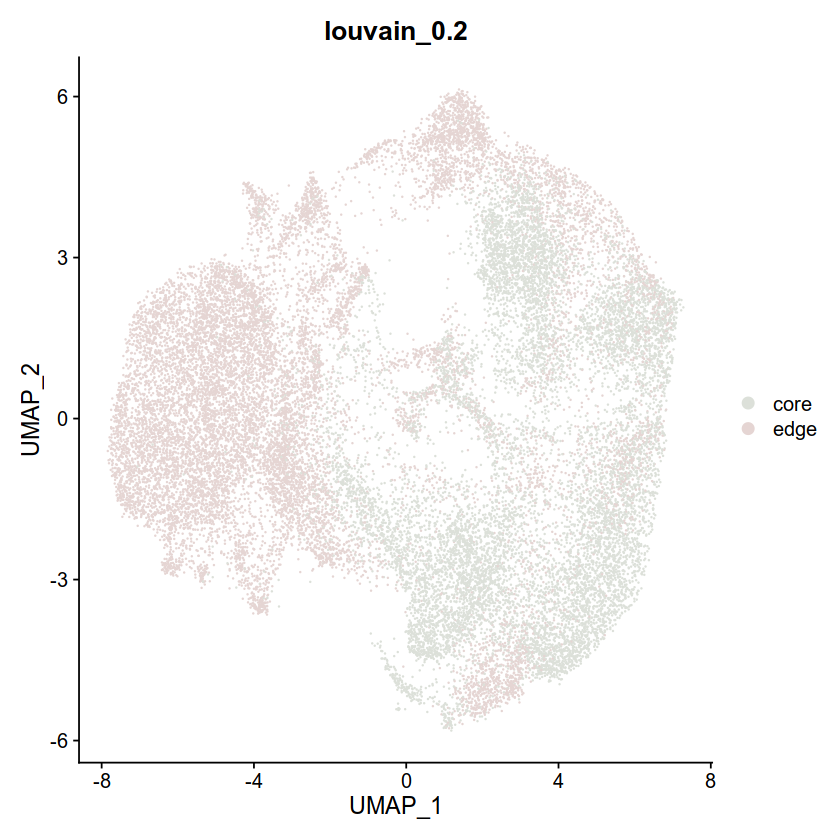

In [301]:
DimPlot(alldata.int, reduction = "umap", group.by = "type",cols = c("#dce0d9","#e5d5d3")) + ggtitle("louvain_0.2")
#DimPlot(alldata.int, reduction = "umap", group.by = "patient",cols = c("#dce0d9","#e5d5d3")) + ggtitle("louvain_0.2")

#pdf("patient.tsne.pdf")
#DimPlot(alldata.int, reduction = "umap", group.by = "type",cols = c("#a06b9a","#899878")) + ggtitle("louvain_0.2")
#dev.off()

In [302]:
#length(filtered_seurat$RNA_snn_res.1.5)
print ("1")
table(alldata.int$CCA_snn_res.0.1)
print ("0.2")
table(alldata.int$CCA_snn_res.0.2)
print ("0.3")
table(alldata.int$CCA_snn_res.0.3)
print ("0.4")
table(alldata.int$CCA_snn_res.0.4)
print ("0.6")
table(alldata.int$CCA_snn_res.0.6)
print ("0.8")
table(alldata.int$CCA_snn_res.0.8)

[1] "1"



    0     1     2 
11256  9914  6500 

[1] "0.2"



   0    1    2    3    4    5 
9295 6492 5635 3212 1800 1236 

[1] "0.3"



   0    1    2    3    4    5    6 
9233 5632 4816 3223 1815 1678 1273 

[1] "0.4"



   0    1    2    3    4    5    6    7 
8681 5728 4714 3219 1857 1687 1318  466 

[1] "0.6"



   0    1    2    3    4    5    6    7    8    9   10   11 
4684 4206 3196 2865 2596 2469 2253 1709 1607 1359  495  231 

[1] "0.8"



   0    1    2    3    4    5    6    7    8    9   10   11   12   13 
4148 3606 3175 2598 2452 2254 2166 1702 1357 1077 1068  816  754  497 

In [303]:
#alldata.int<-FindClusters(alldata.int,resolution=0.4,algorithm=1)
cell_selection <- SetIdent(alldata.int, value = "CCA_snn_res.0.1")
markers_genes <- FindAllMarkers(cell_selection, log2FC.threshold = 0.5, test.use = "wilcox",
    min.pct = 0.2, min.diff.pct = 0.2, only.pos = TRUE ,features = VariableFeatures(cell_selection),
    assay = "RNA")

#markers_genes %>% group_by(cluster) %>% top_n(-25, p_val_adj) -> top25




Calculating cluster 0

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30].

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send

Calculating cluster 1

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30].

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send

Calculating cluster 2

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30].

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send

In [304]:
markers_genes %>% group_by(cluster) %>% top_n(-25, p_val_adj) -> top25



Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


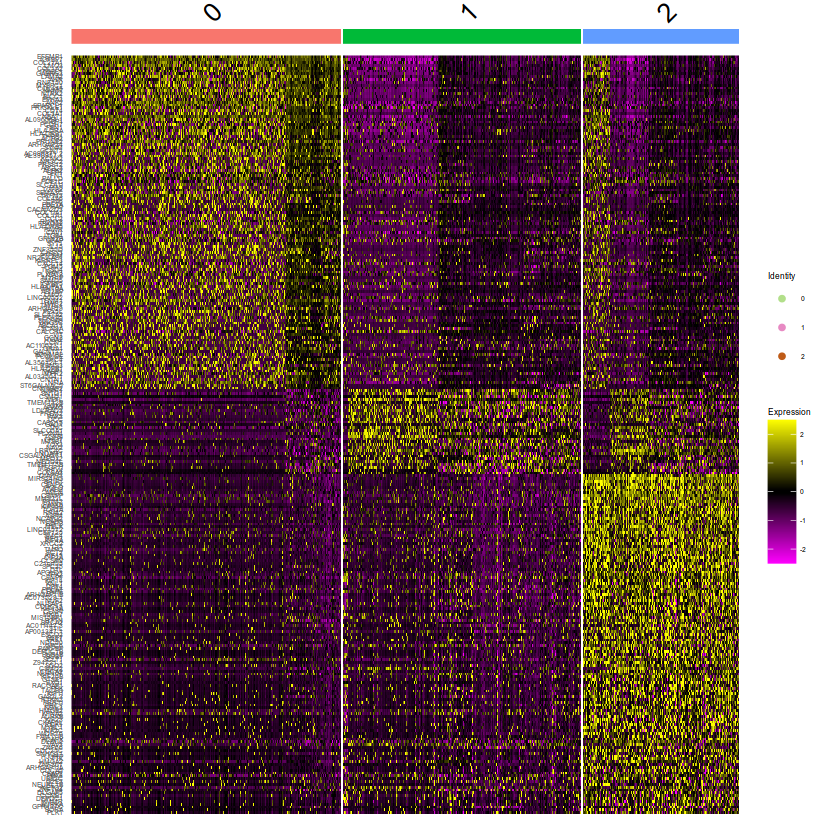

In [305]:
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(cell_selection, features = as.character(unique(top25$gene)), group.by = "CCA_snn_res.0.1")+scale_color_manual(values=col)+theme(text = element_text(size = 5))

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


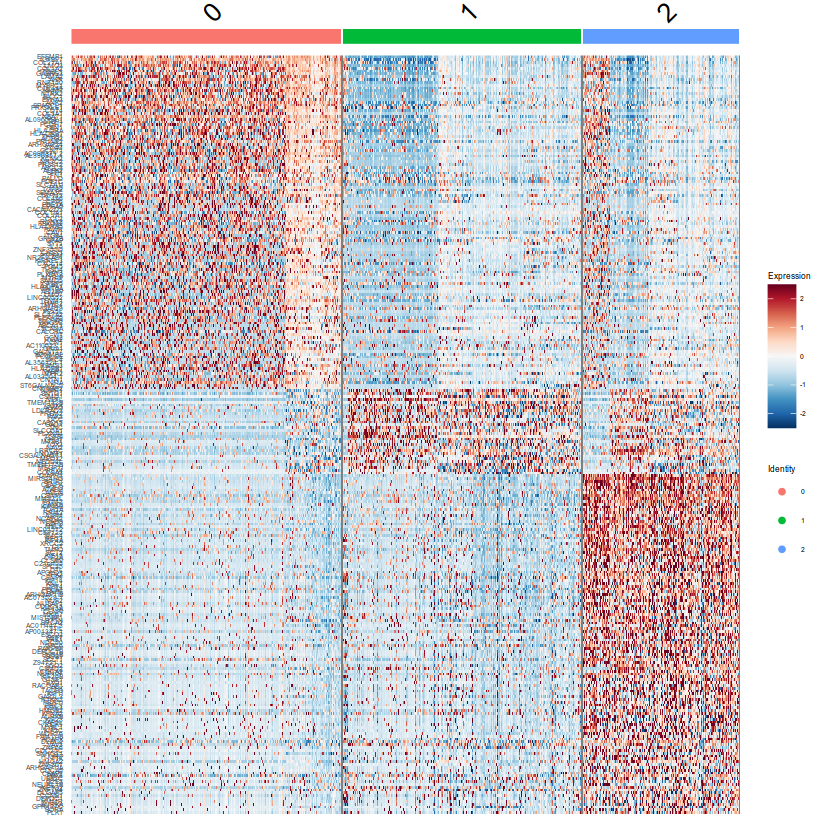

In [306]:
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
DoHeatmap(cell_selection, features = as.character(unique(top25$gene)), group.by = "CCA_snn_res.0.1")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


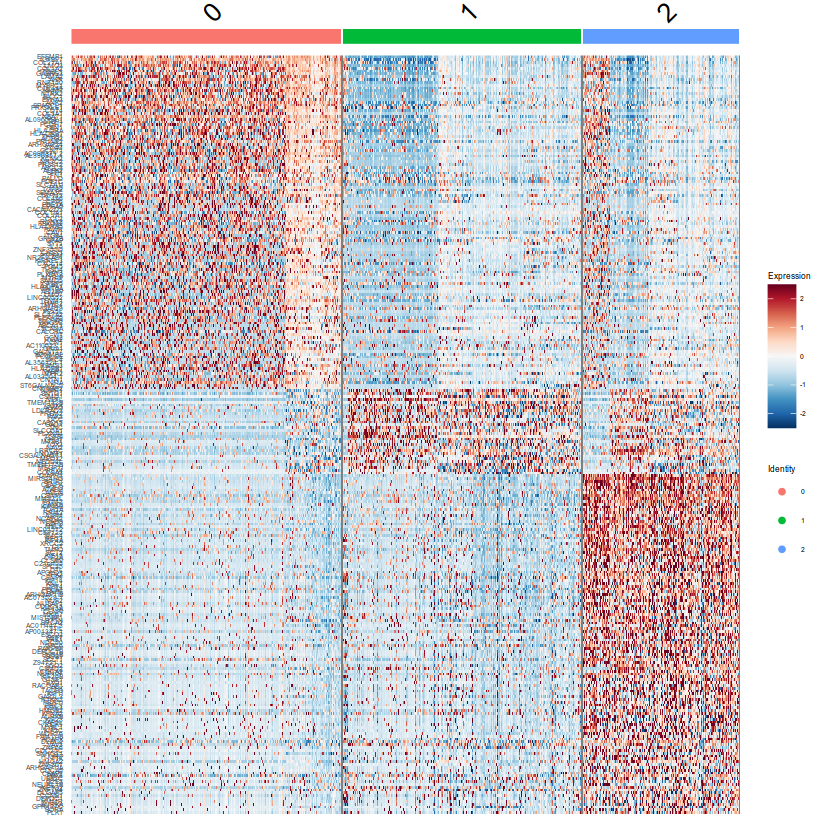

In [307]:
markers_genes %>% group_by(cluster) %>% top_n(-10, p_val_adj) -> top25
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
DoHeatmap(cell_selection, features = as.character(unique(top25$gene)), group.by = "CCA_snn_res.0.1")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))

In [308]:
markers_genes[markers_genes$cluster == 0,]$gene

[1] "EFEMP1"     "IGFBP7"     "COL21A1"    "LMO3"       "COL1A2"    
  [6] "ITGBL1"     "GABRG3"     "LAMA2"      "AHR"        "RNF150"    
 [11] "MYBPC1"     "COL4A5"     "NNMT"       "NTRK2"      "BICC1"     
 [16] "EPHA3"      "ANK2"       "SPARCL1"    "PRICKLE1"   "CD74"      
 [21] "COL3A1"     "NEAT1"      "AL096854.1" "LTBP1"      "PCDH7"     
 [26] "FBN1"       "HLA-DRA"    "HLA-DRB1"   "THBS1"      "ACTG2"     
 [31] "PRUNE2"     "ARHGAP24"   "SYNM"       "GCNT1"      "AC090371.2"
 [36] "AL390957.1" "KCNK2"      "NR3C2"      "PRSS12"     "ABCC3"     
 [41] "ALPK2"      "SPP1"       "FN1"        "PALLD"      "PDE1C"     
 [46] "SLC7A11"    "PI15"       "TGFB2"      "SEMA3C"     "TRPM3"     
 [51] "COL4A6"     "CPA6"       "PDE1A"      "EPHA5"      "CACNA2D3"  
 [56] "COL11A1"    "COL1A1"     "CCL2"       "RUNX2"      "FBXO32"    
 [61] "HLA-DRB5"   "PAWR"       "CAV1"       "ITGB4"      "GRIN2B"    
 [66] "GFAP"       "SYT1"       "IL15"       "ZNF385D"    "CHSY3"     
 [71] "PTPRM"      "NR2F2-AS1"  "KIRREL3"    "CXCL14"     "PGM5"      
 [76] "THSD4"      "NAV3"       "PLXDC2"     "MYRIP"      "SAMD5"     
 [81] "IGFBP5"     "HLA-DPA1"   "WNT5A"      "ABI3BP"     "LMO7"      
 [86] "LINC00882"  "TENM1"      "VWC2"       "TMTC1"      "ARHGAP29"  
 [91] "PEX5L"      "SLC47A2"    "PLEKHA5"    "SLC9A9"     "UNC5C"     
 [96] "ABCA13"     "SCN9A"      "CALCRL"     "VIT"        "CCN2"      
[101] "ITGA2"      "CCN1"       "AC110023.1" "GRIA1"      "GALNT17"   
[106] "KCNMB2"     "PCOLCE"     "SHC4"       "AL356124.1" "RBMS3"     
[111] "HLA-DPB1"   "NABP1"      "ITPR2"      "AL033504.1" "CNTN1"     
[116] "NFIA"       "ST6GALNAC5" "CNTNAP2"    "CDH13"      "SERPINE1"  
[121] "ZFPM2"      "KCNIP4"

In [309]:
markers_genes[markers_genes$cluster == 1,]$gene

[1] "NXPH1"      "SNTG1"      "CSMD1"      "NEFL"       "TMEM132B"  
 [6] "SOX4"       "AGMO"       "LDLRAD3"    "FREM2"      "PAK3"      
[11] "DCC"        "CASC15"     "GAD1"       "TNC"        "SLCO5A1"   
[16] "PLXNA4"     "TGFBI"      "CHD7"       "MTSS1"      "TOX3"      
[21] "NAV2"       "LRRC4C"     "NCAM1"      "CSGALNACT1" "MEOX2"     
[26] "NEDD4L"     "TMEM178B"   "MEGF11"     "RFX4"       "COL9A3"    
[31] "C1orf61"    "WSCD1"      "COL22A1"    "LHFPL3"     "CSMD2"

In [310]:
#select specific type to do comparison 
cell_selection <- SetIdent(alldata.int, value = "type")

In [311]:
DGE_cell_selection <- FindAllMarkers(cell_selection, log2FC.threshold = 0.5, test.use = "wilcox",
    min.pct = 0.2, min.diff.pct = 0.2, only.pos = TRUE,features = VariableFeatures(cell_selection), min.cells.group = 10000, min.cells.feature = 10000,
    assay = "RNA")

Calculating cluster edge

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-3

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send

Calculating cluster core

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-3

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send

In [312]:
DGE_cell_selection %>% group_by(cluster) %>% top_n(-25, p_val_adj) -> top25



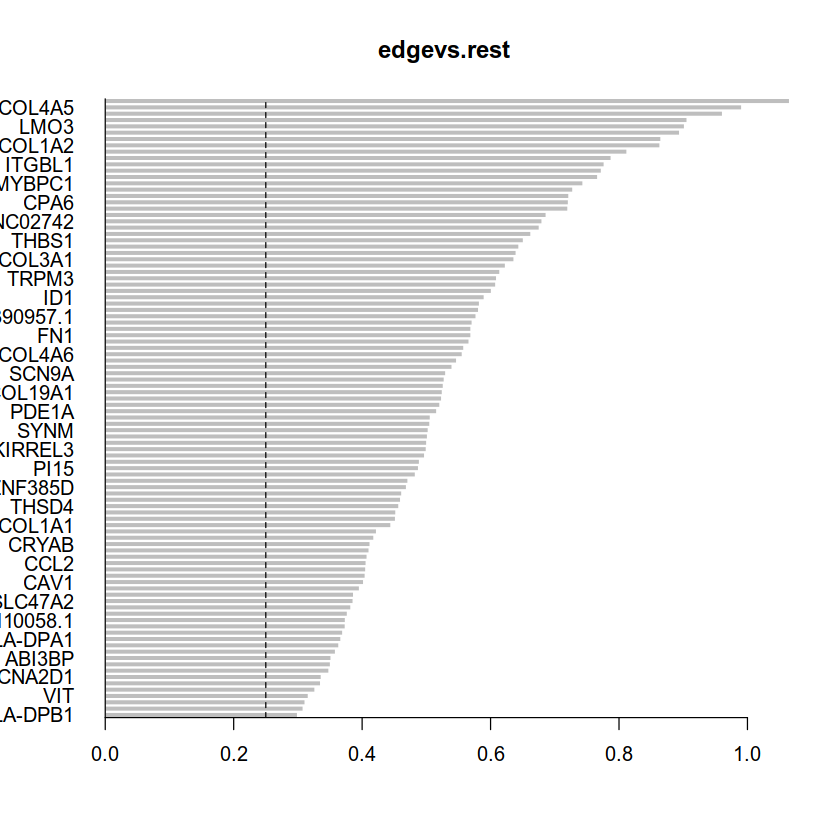

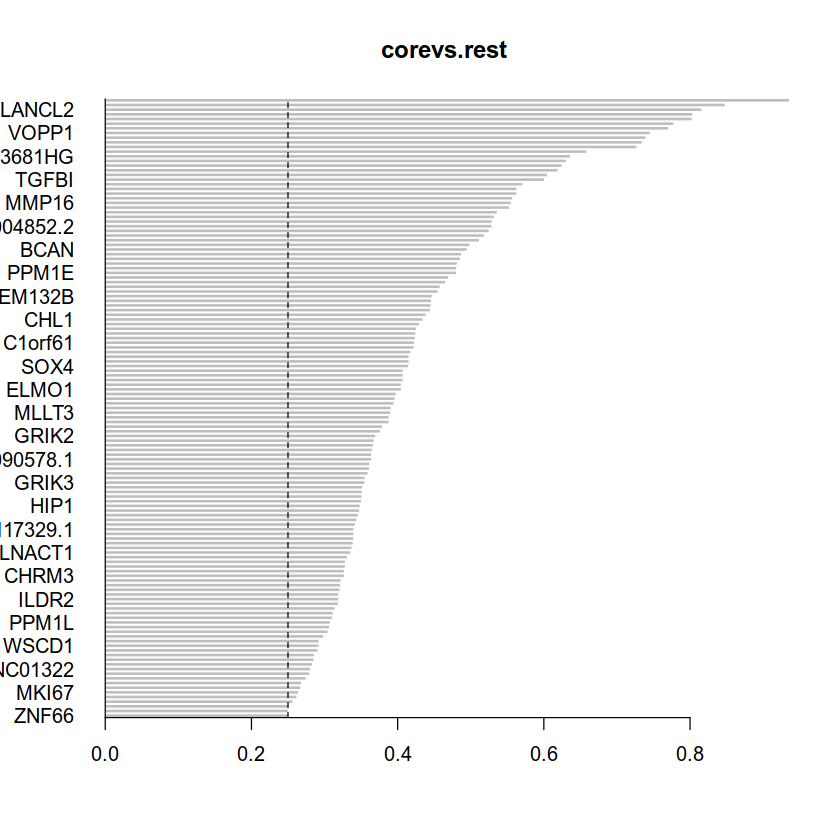

In [313]:
for (i in unique(top25$cluster)){
    barplot(sort(setNames(top25$avg_log2FC,top25$gene)[top25$cluster==i],F),
    horiz=T,las=1,main=paste0(i,"vs.rest"),border="white",yaxs = "i")
    abline(v=c(0,0.25),lty=c(1,2))
}

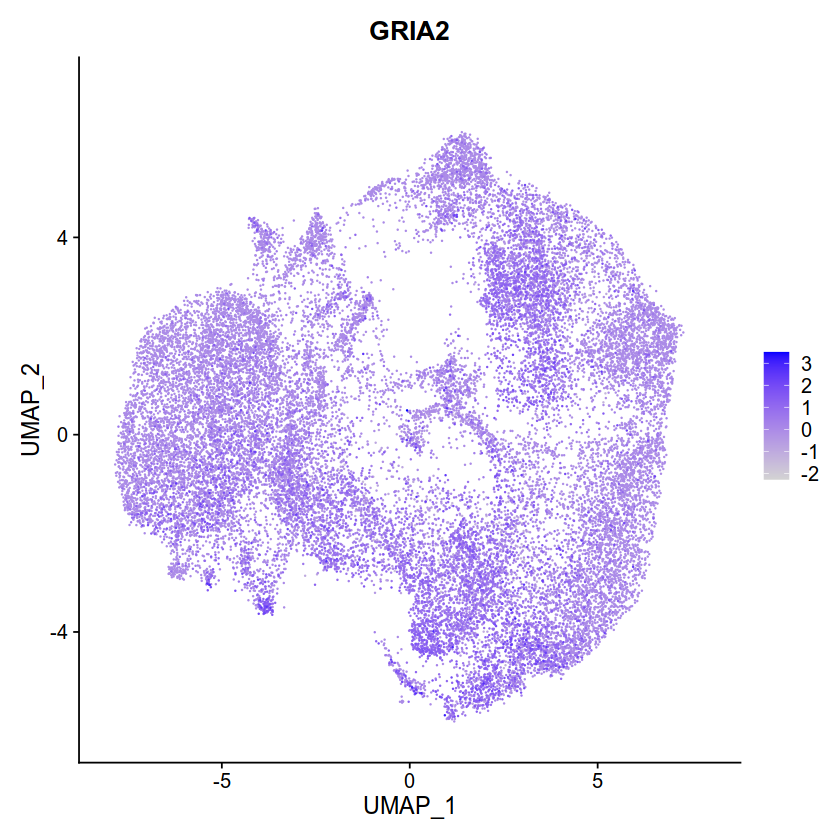

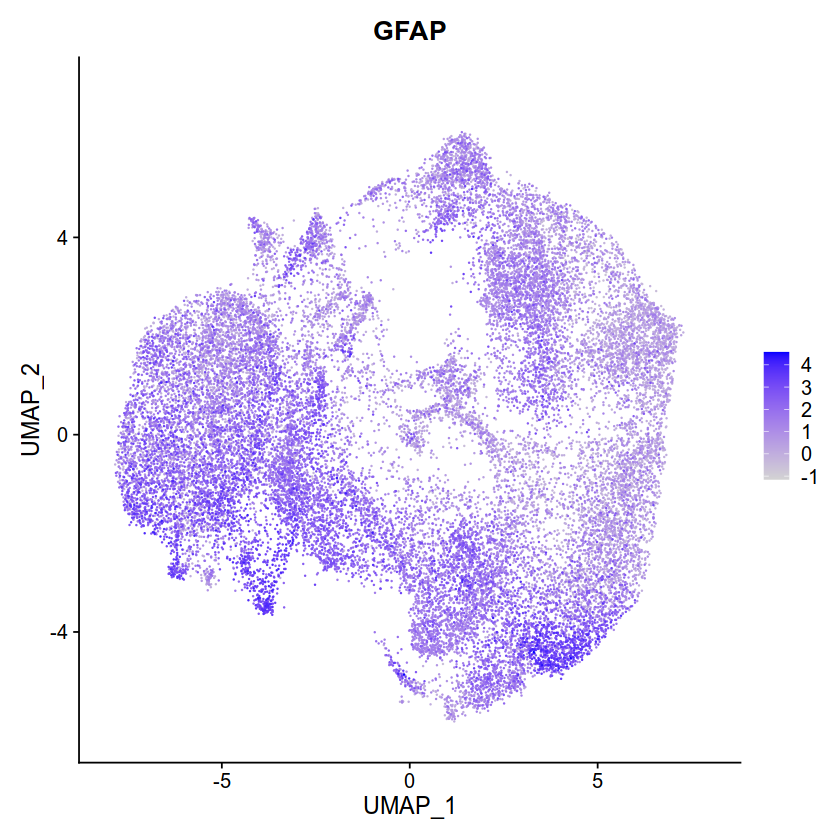

In [314]:
FeaturePlot(alldata.int,reduction="umap",dims=1:2,features="GRIA2",order=T)
FeaturePlot(alldata.int,reduction="umap",dims=1:2,features="GFAP",order=T)

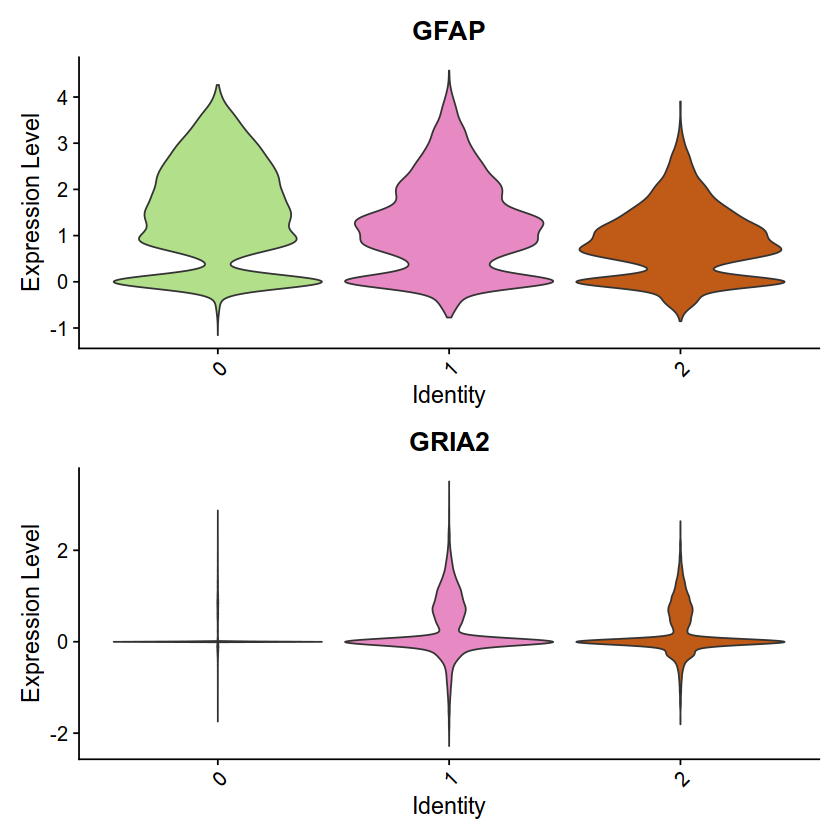

In [315]:
VlnPlot(alldata.int, features = c("GFAP","GRIA2"),group.by = "CCA_snn_res.0.1",cols=col,ncol=1,pt.size=0)

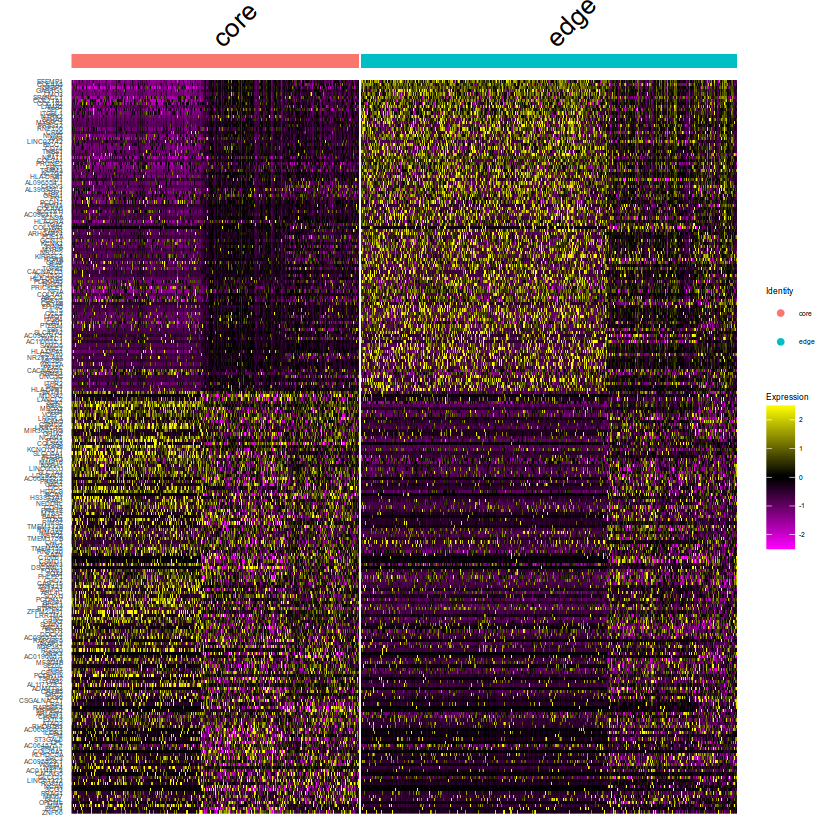

In [316]:
DGE_cell_selection %>% group_by(cluster) %>% top_n(-5,p_val_adj) -> top5
 
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(alldata.int, features = as.character(unique(top5$gene)), group.by = "type")+theme(text = element_text(size = 5))

In [318]:
library(ggplot2)

In [319]:
table(alldata.int$type,alldata.int$CCA_snn_res.0.4)

      
          0    1    2    3    4    5    6    7
  core  362 3911 2447 3112   51 1448  650    4
  edge 8319 1817 2267  107 1806  239  668  462

In [320]:
a<-table(alldata.int$type,alldata.int$CCA_snn_res.0.1)

In [321]:
new<-t(t(a)/colSums(a))
new2<-data.frame(new)

In [322]:
new2$Var1<-factor(new2$Var1,levels=c("core","edge"))

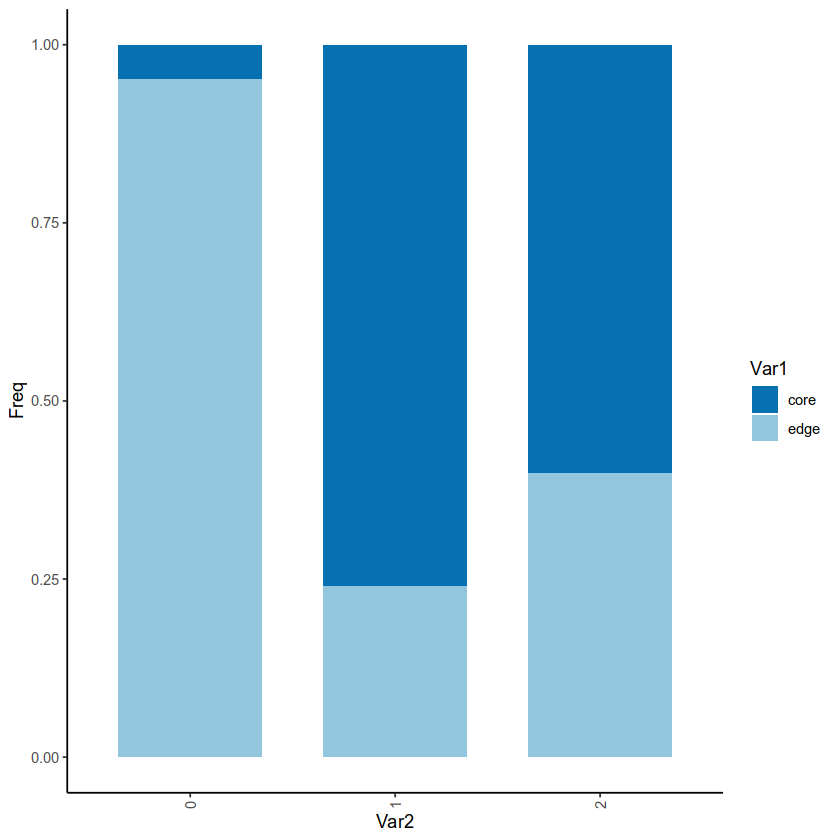

In [323]:
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=c("#0571B0","#92C5DE","#F4A582","#CA0020"))+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [324]:
new<-t(a/rowSums(a))
new2<-data.frame(new)


In [325]:
new2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,core,0.04564038
1,core,0.62861911
2,core,0.32574051
0,edge,0.68275422
1,edge,0.15173733
2,edge,0.16550845


In [326]:
new2$Var2<-factor(new2$Var2,levels=c("core","edge"))

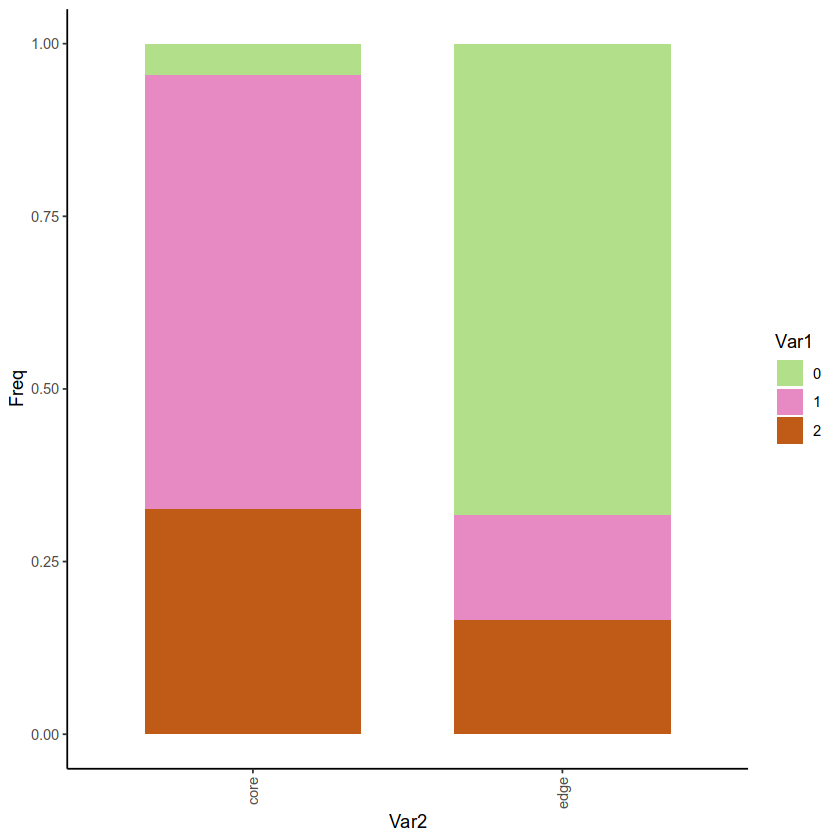

In [327]:
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

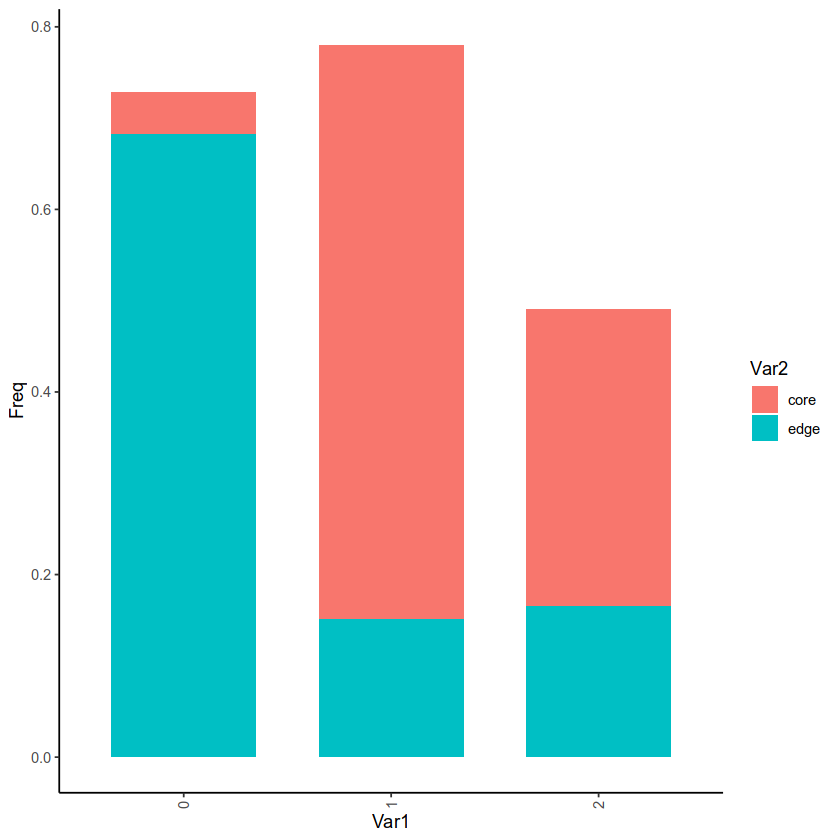

In [328]:
ggplot(new2, aes( y=Freq, x=Var1))+geom_col(aes(fill = Var2 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [330]:
library("ggsignif")
library(ggpubr)
my_comparison<-list(c("core","edge"))

In [331]:
table(alldata.int$patient,alldata.int$CCA_snn_res.0.1)

          
              0    1    2
  patient1 8951 3948 2747
  patient2 1452 3587 2271
  patient3  853 2379 1482

In [332]:
a<-table(alldata.int$patient,alldata.int$CCA_snn_res.0.1)

In [333]:
new<-t(a/rowSums(a))
new2<-data.frame(new)

In [334]:
new2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,patient1,0.5720951
1,patient1,0.2523329
2,patient1,0.1755720
0,patient2,0.1986320
1,patient2,0.4906977
2,patient2,0.3106703
0,patient3,0.1809504
1,patient3,0.5046669
2,patient3,0.3143827


In [335]:
new2$Var2<-factor(new2$Var2,levels=c("patient1","patient2","patient3"))

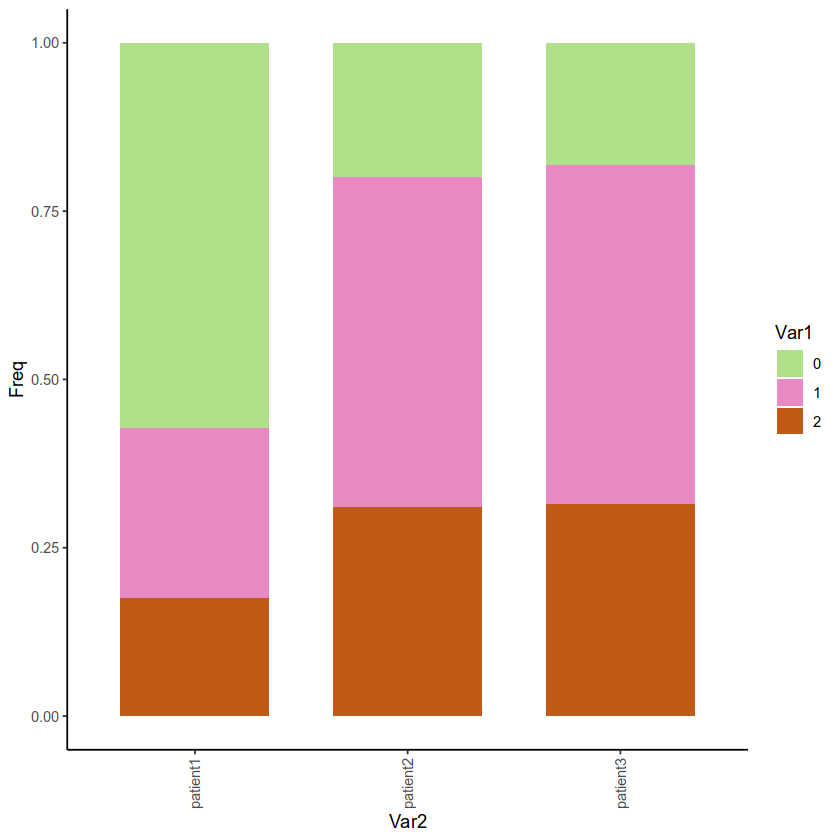

In [336]:
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [337]:
new2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,patient1,0.5720951
1,patient1,0.2523329
2,patient1,0.1755720
0,patient2,0.1986320
1,patient2,0.4906977
2,patient2,0.3106703
0,patient3,0.1809504
1,patient3,0.5046669
2,patient3,0.3143827


In [338]:
new2$type<-rep(c(rep("core",3),rep("edge",3)),6)

ERROR: Error in `$<-.data.frame`(`*tmp*`, type, value = c("core", "core", "core", : replacement has 36 rows, data has 9


In [ ]:
ggplot(new2,aes( y=Freq, x=Var2,fill=type))+geom_boxplot()+geom_signif(comparisons = my_comparison,map_signif_level=F)

In [ ]:
ggboxplot(new2, x="type", y="Freq",facet.by = "Var2")+theme_classic()+xlab("")+ylab("RMA")+scale_fill_manual(values=c("#00AFBB", "#E7B800"))+stat_compare_means(comparisons = my_comparison,label="p.signif",method="t.test",paired=F)

In [ ]:
new<-t(a/rowSums(a))
new2<-data.frame(new)


In [ ]:
new2$Var2<-factor(new2$Var2,levels=c("core1","core2","core3","edge1","edge2","edge3"))

In [ ]:
ggplot(new2, aes( y=Freq, x=Var2))+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [ ]:
ggplot(new2, aes( y=Freq, x=Var1))+geom_col(aes(fill = Var2 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [ ]:
col

In [ ]:

new2$type<-c(rep("core",length(grep("core",new2$Var2))),rep("edge",length(grep("edge",new2$Var2))))

In [ ]:
library("ggsignif")
library(ggpubr)

In [ ]:
my_comparison<-list(c("core","edge"))

In [ ]:
ggplot(new2,aes( y=Freq, x=Var1,fill=type))+geom_boxplot()+geom_signif(comparisons = my_comparison,map_signif_level=F)

In [ ]:
ggboxplot(new2, x="type", y="Freq",facet.by = "Var1")+theme_classic()+xlab("")+ylab("RMA")+scale_fill_manual(values=c("#00AFBB", "#E7B800"))+stat_compare_means(comparisons = my_comparison,label="p.signif",method="t.test",paired=T)

In [ ]:
new2[which(new2$Var1 == "1"),]

q<-data.frame(new2[which(new2$Var1 == "1"),]$Freq[1:3],new2[which(new2$Var1 == "1"),]$Freq[4:6])
colnames(q)<-c("core","edge")
rownames(q)<-c("patient1","patient2","patinet3")

In [ ]:
new2[which(new2$Var1 == "2"),]

In [ ]:
q<-data.frame(new2[which(new2$Var1 == "2"),]$Freq[1:3],new2[which(new2$Var1 == "2"),]$Freq[4:6])
colnames(q)<-c("core","edge")
rownames(q)<-c("patient1","patient2","patinet3")

In [ ]:
library(rstatix)
pairwise_fisher_test(as.matrix(q), p.adjust.method = "fdr")

In [ ]:
mosaicplot(q, color = TRUE)  

In [ ]:
library(presto)

In [ ]:
pbmc.genes <- wilcoxauc(alldata.int, 'CCA_snn_res.0.4')

In [ ]:
dplyr::count(pbmc.genes, group)

In [ ]:
library(msigdbr)
library(fgsea)
library(dplyr)
library(ggplot2)
#library(tibble)

In [ ]:
m_df<- msigdbr(species = "Homo sapiens", category = "C2",subcategory = "CGP")#我们使用H
#m_df<- msigdbr(species = "Homo sapiens", category = "C2",subcategory = "KEGG")
#m_df<- msigdbr(species = "Homo sapiens", category = "C2",subcategory = "REACTOME")
#m_df<- msigdbr(species = "Homo sapiens", category = "C5",subcategory = "BP")


In [ ]:
fgsea_sets<- m_df %>% split(x = .$gene_symbol, f = .$gs_name)

In [ ]:
pbmc.genes %>%
  dplyr::filter(group == "1") %>%
  arrange(desc(logFC), desc(auc)) %>%
  head(n = 10) 

In [ ]:
cluster0.genes<- pbmc.genes %>%
  dplyr::filter(group == "1") %>%
  arrange(desc(auc)) %>%
  dplyr::select(feature, auc)

ranks<-as.vector(unlist(cluster0.genes$auc))
names(ranks)<-cluster0.genes$feature
head(ranks)

In [ ]:
fgseaRes<- fgsea(fgsea_sets, stats = ranks, nperm = 1000)

In [ ]:
fgseaResTidy <- fgseaRes %>%
  as_tibble() %>%
  arrange(desc(NES))

fgseaResTidy %>%
  dplyr::select(-leadingEdge, -ES, -nMoreExtreme) %>%
  arrange(padj) %>% head(20)

In [ ]:
# 显示top20信号通路
ggplot(fgseaResTidy %>% filter(padj < 0.01) %>% head(n= 20), aes(reorder(pathway, NES), NES)) +
  geom_col(aes(fill= NES < 10)) +
  coord_flip() +
  labs(x="Pathway", y="Normalized Enrichment Score",
       title="Hallmark pathways NES from GSEA") +
  theme_minimal() ####以7.5进行绘图填色

In [ ]:
cluster0.genes<- pbmc.genes %>%
  dplyr::filter(group == "2") %>%
  arrange(desc(auc)) %>%
  dplyr::select(feature, auc)

In [ ]:
ranks<-as.vector(unlist(cluster0.genes$auc))
names(ranks)<-cluster0.genes$feature
head(ranks)

In [ ]:
fgseaRes<- fgsea(fgsea_sets, stats = ranks, nperm = 1000)

In [ ]:
fgseaResTidy <- fgseaRes %>%
  as_tibble() %>%
  arrange(desc(NES))

fgseaResTidy %>%
  dplyr::select(-leadingEdge, -ES, -nMoreExtreme) %>%
  arrange(padj) %>% head(70)

In [ ]:
# 显示top20信号通路
ggplot(fgseaResTidy %>% filter(padj < 0.25) %>% head(n= 20), aes(reorder(pathway, NES), NES)) +
  geom_col(aes(fill= NES < 10)) +
  coord_flip() +
  labs(x="Pathway", y="Normalized Enrichment Score",
       title="Hallmark pathways NES from GSEA") +
  theme_minimal() ####以7.5进行绘图填色